<a href="https://colab.research.google.com/github/tkuri/albumentations_test/blob/master/albumentations_test.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Load Image

     |████████████████████████████████| 122kB 2.9MB/s 
     |████████████████████████████████| 634kB 8.8MB/s 
  Created wheel for albumentations: filename=albumentations-0.4.5-cp36-none-any.whl size=64378 sha256=2e4a9339a26eb930863107271ad6f3068ea4da442da4eac865176dc71bcc31c0
  Stored in directory: /root/.cache/pip/wheels/f0/a0/61/e50f93165a5ec7e7f5d65064e513239505bc4c06d2289557d3
  Created wheel for imgaug: filename=imgaug-0.2.6-cp36-none-any.whl size=654020 sha256=cfdd55062c26d88e42a94dafab26df49f8b46dced4fa15b61d4da0c6aba5e5ae
  Stored in directory: /root/.cache/pip/wheels/97/ec/48/0d25896c417b715af6236dbcef8f0bed136a1a5e52972fc6d0
Successfully built albumentations imgaug
  Found existing installation: imgaug 0.2.9
    Uninstalling imgaug-0.2.9:
      Successfully uninstalled imgaug-0.2.9
  Found existing installation: albumentations 0.1.12
    Uninstalling albumentations-0.1.12:
      Successfully uninstalled albumentations-0.1.12


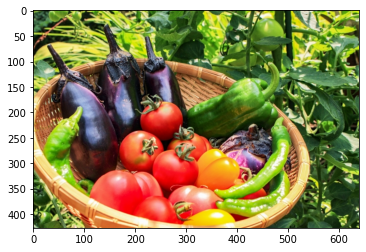

In [1]:
!pip install -U albumentations
import matplotlib.pyplot as plt
import albumentations as A
import numpy as np
import cv2
%matplotlib inline

img_path = '/content/drive/My Drive/Colabdata/test/test.jpg'
# img_path = 'test.jpg'

img = cv2.imread(img_path, cv2.IMREAD_COLOR)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB).astype(np.uint8)
plt.imshow(img)

# ボカす系 (Blur)

## Blur
### Blur the input image using a random-sized kernel.
### ランダムサイズのカーネルでボカす
* blur_limit: maximum kernel size for blurring the input image. (最大カーネルサイズ), Default: (3, 7)

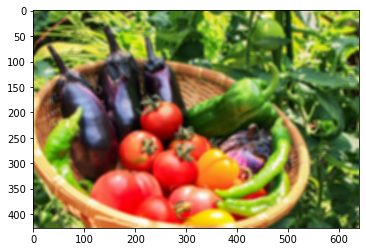

In [2]:
a = A.Blur(p=1)(image=img)
plt.imshow(a['image'])

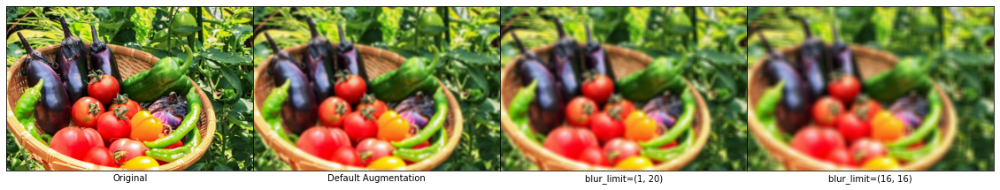

In [3]:
aug = []
n = 3
param1 = (1, 20)
param2 = (16, 16)
aug.append(A.Compose([A.Blur(p=1)]))
aug.append(A.Compose([A.Blur(blur_limit=param1, p=1)]))
aug.append(A.Compose([A.Blur(blur_limit=param2, p=1)]))
aug_img = [aug[i](image=img) for i in range(n)]

fig, ax = plt.subplots(1, 1+n, figsize=(5+5*n, 5))
plt.subplots_adjust(wspace=0)
plt.rcParams["font.size"] = 18
[ax[i].tick_params(bottom=False, left=False, right=False, top=False, labelbottom=False, labelleft=False, labelright=False, labeltop=False) for i in range(1+n)]

ax[0].set_xlabel("Original")
ax[1].set_xlabel("Default Augmentation")
ax[2].set_xlabel("blur_limit={}".format(param1))
ax[3].set_xlabel("blur_limit={}".format(param2))

ax[0].imshow(img)
[ax[i+1].imshow(aug_img[i]['image']) for i in range(n)]

## MotionBlur
### Apply motion blur to the input image using a random-sized kernel.
### ランダムなカーネルサイズでモーションブラー(ボックスフィルタ)をかける
* blur_limit (int) – maximum kernel size for blurring the input image. Should be in range [3, inf). Default: (3, 7).
 * ブラーの最大カーネルサイズ

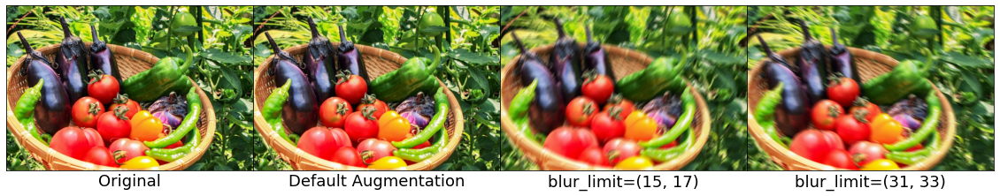

In [4]:
aug = []
n = 3
param1 = (15, 17)
param2 = (31, 33)
aug.append(A.Compose([A.MotionBlur(p=1)]))
aug.append(A.Compose([A.MotionBlur(blur_limit=param1, p=1)]))
aug.append(A.Compose([A.MotionBlur(blur_limit=param2, p=1)]))
aug_img = [aug[i](image=img) for i in range(n)]

fig, ax = plt.subplots(1, 1+n, figsize=(5+5*n, 5))
plt.subplots_adjust(wspace=0)
plt.rcParams["font.size"] = 18
[ax[i].tick_params(bottom=False, left=False, right=False, top=False, labelbottom=False, labelleft=False, labelright=False, labeltop=False) for i in range(1+n)]

ax[0].set_xlabel("Original")
ax[1].set_xlabel("Default Augmentation")
ax[2].set_xlabel("blur_limit={}".format(param1))
ax[3].set_xlabel("blur_limit={}".format(param2))

ax[0].imshow(img)
[ax[i+1].imshow(aug_img[i]['image']) for i in range(n)]

## GaussianBlur
### Blur the input image using using a Gaussian filter with a random kernel size.
### ランダムなカーネルサイズでガウシアンフィルタをかける
* blur_limit (int) – maximum Gaussian kernel size for blurring the input image. Must be zero or odd and in range [3, inf). Default: (3, 7).
 * ブラーをかけるカーネルサイズの最大値、奇数である必要がある

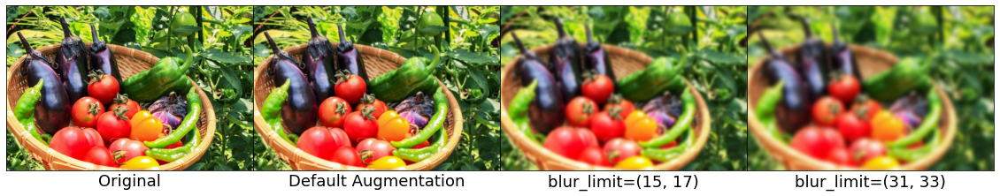

In [5]:
aug = []
n = 3
param1 = (15, 17)
param2 = (31, 33)
aug.append(A.Compose([A.GaussianBlur(p=1)]))
aug.append(A.Compose([A.GaussianBlur(blur_limit=param1, p=1)]))
aug.append(A.Compose([A.GaussianBlur(blur_limit=param2, p=1)]))
aug_img = [aug[i](image=img) for i in range(n)]

fig, ax = plt.subplots(1, 1+n, figsize=(5+5*n, 5))
plt.subplots_adjust(wspace=0)
plt.rcParams["font.size"] = 18
[ax[i].tick_params(bottom=False, left=False, right=False, top=False, labelbottom=False, labelleft=False, labelright=False, labeltop=False) for i in range(1+n)]

ax[0].set_xlabel("Original")
ax[1].set_xlabel("Default Augmentation")
ax[2].set_xlabel("blur_limit={}".format(param1))
ax[3].set_xlabel("blur_limit={}".format(param2))

ax[0].imshow(img)
[ax[i+1].imshow(aug_img[i]['image']) for i in range(n)]

## MedianBlur
### Blur the input image using using a median filter with a random aperture linear size.
### ランダムなカーネルサイズでメディアンフィルタをかける
* blur_limit (int) – maximum aperture linear size for blurring the input image. Must be odd and in range [3, inf). Default: (3, 7).
 * ブラーをかけるカーネルサイズの最大値、奇数である必要がある

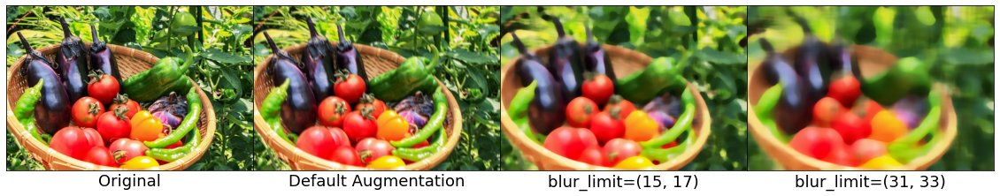

In [6]:
aug = []
n = 3
param1 = (15, 17)
param2 = (31, 33)
aug.append(A.Compose([A.MotionBlur(p=1)]))
aug.append(A.Compose([A.MedianBlur(blur_limit=param1, p=1)]))
aug.append(A.Compose([A.MedianBlur(blur_limit=param2, p=1)]))
aug_img = [aug[i](image=img) for i in range(n)]

fig, ax = plt.subplots(1, 1+n, figsize=(5+5*n, 5))
plt.subplots_adjust(wspace=0)
plt.rcParams["font.size"] = 18
[ax[i].tick_params(bottom=False, left=False, right=False, top=False, labelbottom=False, labelleft=False, labelright=False, labeltop=False) for i in range(1+n)]

ax[0].set_xlabel("Original")
ax[1].set_xlabel("Default Augmentation")
ax[2].set_xlabel("blur_limit={}".format(param1))
ax[3].set_xlabel("blur_limit={}".format(param2))

ax[0].imshow(img)
[ax[i+1].imshow(aug_img[i]['image']) for i in range(n)]

## GlassBlur
### Apply glass noise to the input image.
### グラスノイズ(曇りガラスのような効果)を付加
* sigma (float) – standard deviation for Gaussian kernel. Defalt: 0.7.
 * ガウシアンカーネルの標準偏差
* max_delta (int) – max distance between pixels which are swapped. Defalt: 4.
 * スワップされる画素間の最大距離
* iterations (int) – number of repeats. Should be in range [1, inf). Default: (2).
 * リピート回数
* mode (str) – mode of computation: fast or exact. Default: “fast”.
 * 計算モード

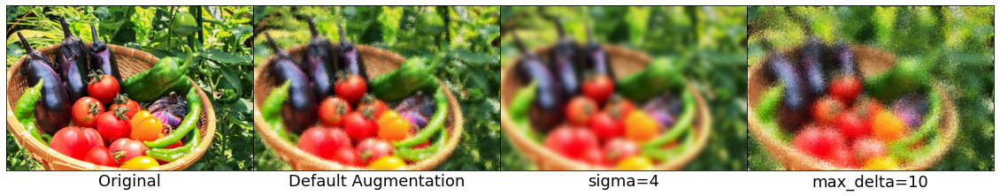

In [7]:
aug = []
n = 3
param1 = 4
param2 = 10
aug.append(A.Compose([A.GlassBlur(p=1)]))
aug.append(A.Compose([A.GlassBlur(sigma=param1, p=1)]))
aug.append(A.Compose([A.GlassBlur(max_delta=param2, p=1)]))
aug_img = [aug[i](image=img) for i in range(n)]

fig, ax = plt.subplots(1, 1+n, figsize=(5+5*n, 5))
plt.subplots_adjust(wspace=0)
plt.rcParams["font.size"] = 18
[ax[i].tick_params(bottom=False, left=False, right=False, top=False, labelbottom=False, labelleft=False, labelright=False, labeltop=False) for i in range(1+n)]

ax[0].set_xlabel("Original")
ax[1].set_xlabel("Default Augmentation")
ax[2].set_xlabel("sigma={}".format(param1))
ax[3].set_xlabel("max_delta={}".format(param2))

ax[0].imshow(img)
[ax[i+1].imshow(aug_img[i]['image']) for i in range(n)]

# ノイズ系 (Noise, Compression)

## GaussNoise
### Apply gaussian noise to the input image.
### ガウスノイズを付加
* var_limit ((float, float) or float) – variance range for noise. If var_limit is a single float, the range will be (0, var_limit). Default: (10.0, 50.0).
 * ノイズ分散
* mean (float) – mean of the noise. Default: 0
 * ノイズ平均

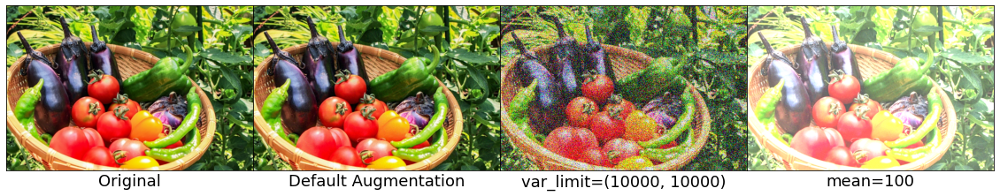

In [8]:
aug = []
n = 3
param1 = (10000, 10000)
param2 = 100
aug.append(A.Compose([A.GaussNoise(p=1)]))
aug.append(A.Compose([A.GaussNoise(var_limit=param1, p=1)]))
aug.append(A.Compose([A.GaussNoise(mean=param2, p=1)]))
aug_img = [aug[i](image=img) for i in range(n)]

fig, ax = plt.subplots(1, 1+n, figsize=(5+5*n, 5))
plt.subplots_adjust(wspace=0)
plt.rcParams["font.size"] = 18
[ax[i].tick_params(bottom=False, left=False, right=False, top=False, labelbottom=False, labelleft=False, labelright=False, labeltop=False) for i in range(1+n)]

ax[0].set_xlabel("Original")
ax[1].set_xlabel("Default Augmentation")
ax[2].set_xlabel("var_limit={}".format(param1))
ax[3].set_xlabel("mean={}".format(param2))

ax[0].imshow(img)
[ax[i+1].imshow(aug_img[i]['image']) for i in range(n)]

## JpegCompression
### Decrease Jpeg compression of an image.
### Jpegの圧縮ノイズを適用
* quality_lower (float) – lower bound on the jpeg quality. Should be in [0, 100] range
 - 品質の下限値
* quality_upper (float) – upper bound on the jpeg quality. Should be in [0, 100] range
 - 品質の上限値

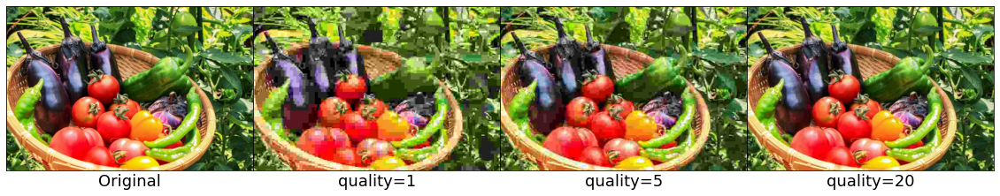

In [9]:
aug = []
n = 3
param1 = 1
param2 = 5
param3 = 20
aug.append(A.Compose([A.JpegCompression(quality_lower=param1, quality_upper=param1, p=1)]))
aug.append(A.Compose([A.JpegCompression(quality_lower=param2, quality_upper=param2, p=1)]))
aug.append(A.Compose([A.JpegCompression(quality_lower=param3, quality_upper=param3, p=1)]))
aug_img = [aug[i](image=img) for i in range(n)]

fig, ax = plt.subplots(1, 1+n, figsize=(5+5*n, 5))
plt.subplots_adjust(wspace=0)
plt.rcParams["font.size"] = 18
[ax[i].tick_params(bottom=False, left=False, right=False, top=False, labelbottom=False, labelleft=False, labelright=False, labeltop=False) for i in range(1+n)]

ax[0].set_xlabel("Original")
ax[1].set_xlabel("quality={}".format(param1))
ax[2].set_xlabel("quality={}".format(param2))
ax[3].set_xlabel("quality={}".format(param3))

ax[0].imshow(img)
[ax[i+1].imshow(aug_img[i]['image']) for i in range(n)]

## ImageCompression
### Decrease Jpeg, WebP compression of an image.
### Jpeg/WebPの圧縮ノイズを適用
* quality_lower (float) – lower bound on the jpeg quality. Should be in [0, 100] range
 - 品質の下限値
* quality_upper (float) – upper bound on the jpeg quality. Should be in [0, 100] range
 - 品質の上限値
* compression_type (ImageCompressionType) – should be ImageCompressionType.JPEG or ImageCompressionType.WEBP. Default: ImageCompressionType.JPEG
 - 圧縮タイプ（JPEG/WEBP）

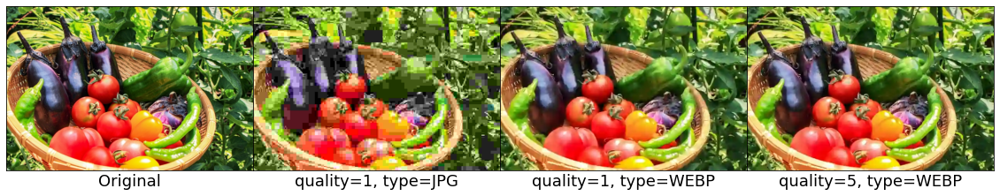

In [10]:
aug = []
n = 3
param1 = 1
param2 = 1
param3 = 5
aug.append(A.Compose([A.ImageCompression(quality_lower=param1, quality_upper=param1, compression_type=A.ImageCompression.ImageCompressionType.JPEG, p=1)]))
aug.append(A.Compose([A.ImageCompression(quality_lower=param2, quality_upper=param2, compression_type=A.ImageCompression.ImageCompressionType.WEBP, p=1)]))
aug.append(A.Compose([A.ImageCompression(quality_lower=param3, quality_upper=param3, compression_type=A.ImageCompression.ImageCompressionType.WEBP, p=1)]))
aug_img = [aug[i](image=img) for i in range(n)]

fig, ax = plt.subplots(1, 1+n, figsize=(5+5*n, 5))
plt.subplots_adjust(wspace=0)
plt.rcParams["font.size"] = 18
[ax[i].tick_params(bottom=False, left=False, right=False, top=False, labelbottom=False, labelleft=False, labelright=False, labeltop=False) for i in range(1+n)]

ax[0].set_xlabel("Original")
ax[1].set_xlabel("quality={}, type=JPG".format(param1))
ax[2].set_xlabel("quality={}, type=WEBP".format(param2))
ax[3].set_xlabel("quality={}, type=WEBP".format(param3))

ax[0].imshow(img)
[ax[i+1].imshow(aug_img[i]['image']) for i in range(n)]

## ISONoise
### Apply camera sensor noise.
### カメラセンサーのノイズを付加する
* color_shift (float, float) – variance range for color hue change. Measured as a fraction of 360 degree Hue angle in HLS colorspace.
* intensity ((float, float) – Multiplicative factor that control strength of color and luminace noise.

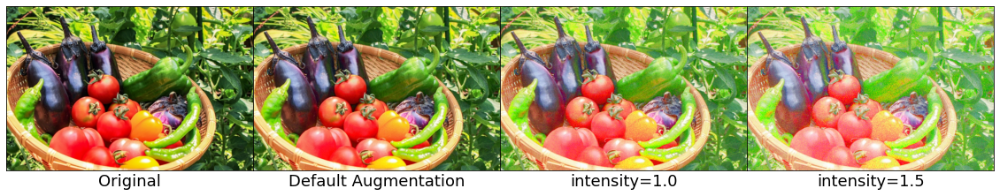

In [11]:
aug = []
n = 3
param1 = 1.0
param2 = 1.5
aug.append(A.Compose([A.ISONoise(p=1)]))
aug.append(A.Compose([A.ISONoise(intensity=(param1,param1), p=1)]))
aug.append(A.Compose([A.ISONoise(intensity=(param2,param2), p=1)]))
aug_img = [aug[i](image=img) for i in range(n)]

fig, ax = plt.subplots(1, 1+n, figsize=(5+5*n, 5))
plt.subplots_adjust(wspace=0)
plt.rcParams["font.size"] = 18
[ax[i].tick_params(bottom=False, left=False, right=False, top=False, labelbottom=False, labelleft=False, labelright=False, labeltop=False) for i in range(1+n)]

ax[0].set_xlabel("Original")
ax[1].set_xlabel("Default Augmentation")
ax[2].set_xlabel("intensity={}".format(param1))
ax[3].set_xlabel("intensity={}".format(param2))

ax[0].imshow(img)
[ax[i+1].imshow(aug_img[i]['image']) for i in range(n)]

## MultiplicativeNoise
### Multiply image to random number or array of numbers.
### 乱数配列と乗算する
* multiplier (float or tuple of floats) – If single float image will be multiplied to this number. If tuple of float multiplier will be in range [multiplier[0], multiplier[1]). Default: (0.9, 1.1).
* per_channel (bool) – If False, same values for all channels will be used. If True use sample values for each channels. Default False.
* elementwise (bool) – If False multiply multiply all pixels in an image with a random value sampled once. If True Multiply image pixels with values that are pixelwise randomly sampled. Defaule: False.

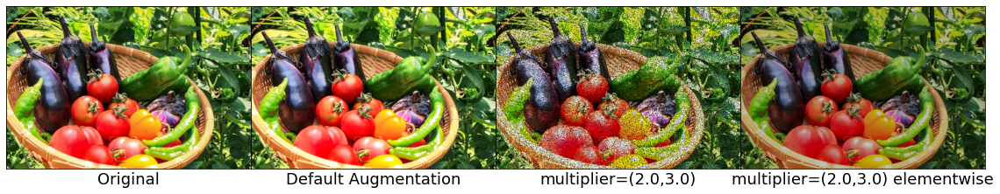

In [12]:
aug = []
n = 3
aug.append(A.Compose([A.MultiplicativeNoise(p=1)]))
aug.append(A.Compose([A.MultiplicativeNoise(multiplier=(2,0, 3.0), elementwise=True, p=1)]))
aug.append(A.Compose([A.MultiplicativeNoise(multiplier=(2,0, 3.0), elementwise=False, p=1)]))
aug_img = [aug[i](image=img) for i in range(n)]

fig, ax = plt.subplots(1, 1+n, figsize=(5+5*n, 5))
plt.subplots_adjust(wspace=0)
plt.rcParams["font.size"] = 18
[ax[i].tick_params(bottom=False, left=False, right=False, top=False, labelbottom=False, labelleft=False, labelright=False, labeltop=False) for i in range(1+n)]

ax[0].set_xlabel("Original")
ax[1].set_xlabel("Default Augmentation")
ax[2].set_xlabel("multiplier=(2.0,3.0)")
ax[3].set_xlabel("multiplier=(2.0,3.0) elementwise")

ax[0].imshow(img)
[ax[i+1].imshow(aug_img[i]['image']) for i in range(n)]

## Downscale
### Decreases image quality by downscaling and upscaling back.
### ダウンスケールした後にアップスケールして画質を低下させる
* scale_min (float) – lower bound on the image scale. Should be < 1. Default: 0.25.
* scale_max (float) – lower bound on the image scale. Should be . Default: 0.25.

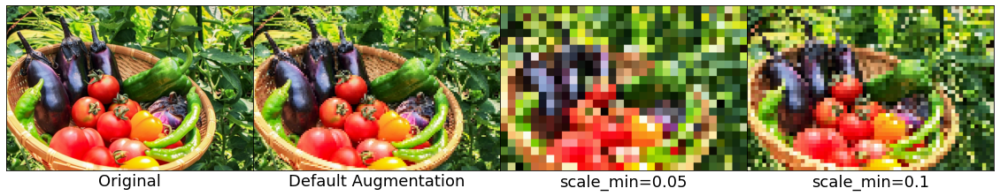

In [13]:
aug = []
n = 3
param1 = 0.05
param2 = 0.1
aug.append(A.Compose([A.Downscale(p=1)]))
aug.append(A.Compose([A.Downscale(scale_min=param1, scale_max=param1, p=1)]))
aug.append(A.Compose([A.Downscale(scale_min=param2, scale_max=param2, p=1)]))
aug_img = [aug[i](image=img) for i in range(n)]

fig, ax = plt.subplots(1, 1+n, figsize=(5+5*n, 5))
plt.subplots_adjust(wspace=0)
plt.rcParams["font.size"] = 18
[ax[i].tick_params(bottom=False, left=False, right=False, top=False, labelbottom=False, labelleft=False, labelright=False, labeltop=False) for i in range(1+n)]

ax[0].set_xlabel("Original")
ax[1].set_xlabel("Default Augmentation")
ax[2].set_xlabel("scale_min={}".format(param1))
ax[3].set_xlabel("scale_min={}".format(param2))

ax[0].imshow(img)
[ax[i+1].imshow(aug_img[i]['image']) for i in range(n)]

# 単純幾何変化系 (Flip, Crop, Rotate, Scale, Transpose)

## Flip
### Flip the input either horizontally, vertically or both horizontally and vertically.
### 水平、垂直、または水平と垂直の両方のどれかにランダムに反転

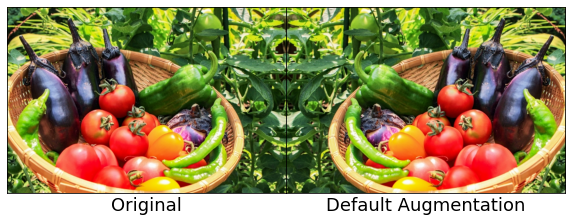

In [14]:
aug = []
n = 1
aug.append(A.Compose([A.Flip(p=1)]))
aug_img = [aug[i](image=img) for i in range(n)]

fig, ax = plt.subplots(1, 1+n, figsize=(5+5*n, 5))
plt.subplots_adjust(wspace=0)
plt.rcParams["font.size"] = 18
[ax[i].tick_params(bottom=False, left=False, right=False, top=False, labelbottom=False, labelleft=False, labelright=False, labeltop=False) for i in range(1+n)]

ax[0].set_xlabel("Original")
ax[1].set_xlabel("Default Augmentation")

ax[0].imshow(img)
[ax[i+1].imshow(aug_img[i]['image']) for i in range(n)]

## VerticalFlip
### Flip the input vertically around the x-axis.
### x軸を中心に垂直に反転

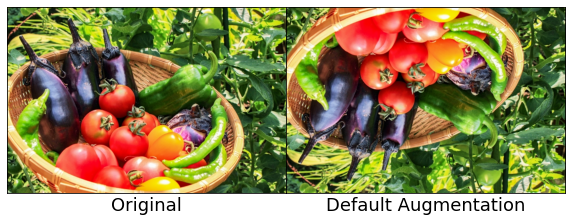

In [15]:
aug = []
n = 1
aug.append(A.Compose([A.VerticalFlip(p=1)]))
aug_img = [aug[i](image=img) for i in range(n)]

fig, ax = plt.subplots(1, 1+n, figsize=(5+5*n, 5))
plt.subplots_adjust(wspace=0)
plt.rcParams["font.size"] = 18
[ax[i].tick_params(bottom=False, left=False, right=False, top=False, labelbottom=False, labelleft=False, labelright=False, labeltop=False) for i in range(1+n)]

ax[0].set_xlabel("Original")
ax[1].set_xlabel("Default Augmentation")

ax[0].imshow(img)
[ax[i+1].imshow(aug_img[i]['image']) for i in range(n)]

## HorizontalFlip
### Flip the input horizontally around the y-axis.
### y軸を中心に水平に反転

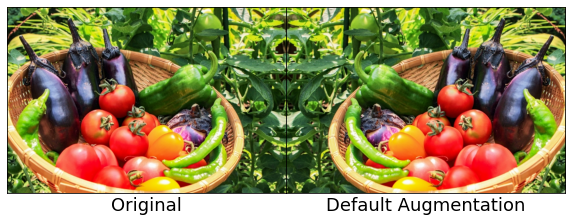

In [16]:
aug = []
n = 1
aug.append(A.Compose([A.HorizontalFlip(p=1)]))
aug_img = [aug[i](image=img) for i in range(n)]

fig, ax = plt.subplots(1, 1+n, figsize=(5+5*n, 5))
plt.subplots_adjust(wspace=0)
plt.rcParams["font.size"] = 18
[ax[i].tick_params(bottom=False, left=False, right=False, top=False, labelbottom=False, labelleft=False, labelright=False, labeltop=False) for i in range(1+n)]

ax[0].set_xlabel("Original")
ax[1].set_xlabel("Default Augmentation")

ax[0].imshow(img)
[ax[i+1].imshow(aug_img[i]['image']) for i in range(n)]

## Crop
### Crop region from image.
### 領域を切り取る
* x_min (int) – Minimum upper left x coordinate.
 - 左上x座標の最小値
* y_min (int) – Minimum upper left y coordinate.
 - 左上y座標の最小値
* x_max (int) – Maximum lower right x coordinate.
 - 右下x座標の最大値
* y_max (int) – Maximum lower right y coordinate.
 - 右下y座標の最大値


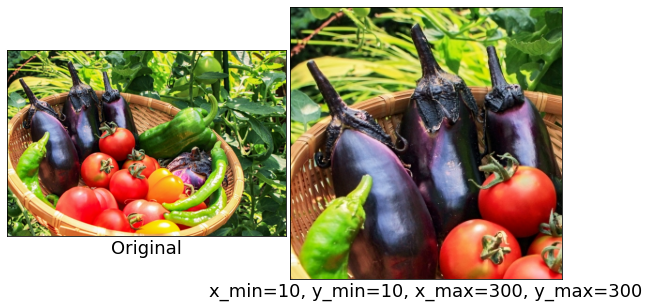

In [17]:
aug = []
n = 1
aug.append(A.Compose([A.Crop(x_min=10, y_min=10, x_max=300, y_max=300, p=1)]))
aug_img = [aug[i](image=img) for i in range(n)]

fig, ax = plt.subplots(1, 1+n, figsize=(5+5*n, 5))
plt.subplots_adjust(wspace=0)
plt.rcParams["font.size"] = 18
[ax[i].tick_params(bottom=False, left=False, right=False, top=False, labelbottom=False, labelleft=False, labelright=False, labeltop=False) for i in range(1+n)]

ax[0].set_xlabel("Original")
ax[1].set_xlabel("x_min=10, y_min=10, x_max=300, y_max=300")

ax[0].imshow(img)
[ax[i+1].imshow(aug_img[i]['image']) for i in range(n)]

## RandomCrop
### Crop a random part of the input.
### ランダムに切り取る
* height: height of the crop. (切り取る高さ)
* width: width of the crop. (切り取る幅)

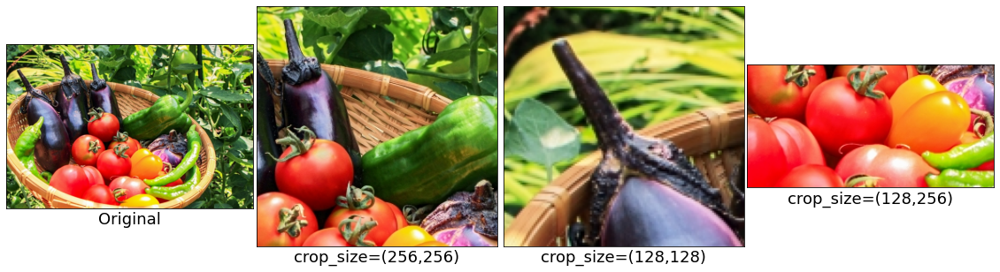

In [18]:
aug = []
n = 3
param1 = 256
param2 = 128
aug.append(A.Compose([A.RandomCrop(height=param1, width=param1, p=1)]))
aug.append(A.Compose([A.RandomCrop(height=param2, width=param2, p=1)]))
aug.append(A.Compose([A.RandomCrop(height=param2, width=param1, p=1)]))
aug_img = [aug[i](image=img) for i in range(n)]

fig, ax = plt.subplots(1, 1+n, figsize=(5+5*n, 5))
plt.subplots_adjust(wspace=0)
plt.rcParams["font.size"] = 18
[ax[i].tick_params(bottom=False, left=False, right=False, top=False, labelbottom=False, labelleft=False, labelright=False, labeltop=False) for i in range(1+n)]

ax[0].set_xlabel("Original")
ax[1].set_xlabel("crop_size=({},{})".format(param1, param1))
ax[2].set_xlabel("crop_size=({},{})".format(param2, param2))
ax[3].set_xlabel("crop_size=({},{})".format(param2, param1))

ax[0].imshow(img)
[ax[i+1].imshow(aug_img[i]['image']) for i in range(n)]

## CenterCrop
### Crop the central part of the input.
### 中心部分をクロップする
* height (int) – height of the crop.
 * クロップする高さ
* width (int) – width of the crop.
 * クロップスする幅

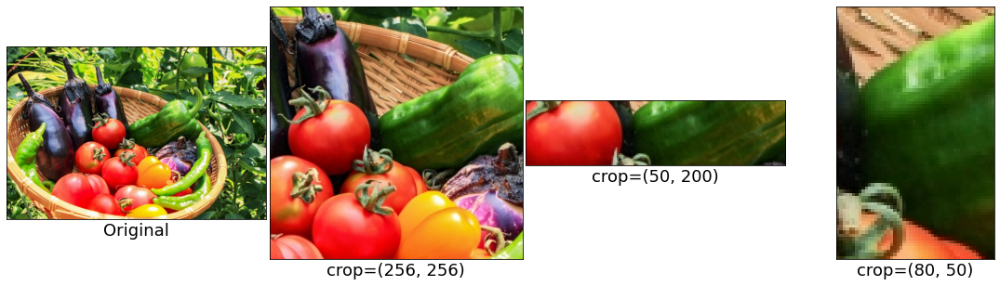

In [19]:
aug = []
n = 3
param1 = (256, 256)
param2 = (50, 200)
param3 = (80, 50)
aug.append(A.Compose([A.CenterCrop(height=param1[0], width=param1[1], p=1)]))
aug.append(A.Compose([A.CenterCrop(height=param2[0], width=param2[1], p=1)]))
aug.append(A.Compose([A.CenterCrop(height=param3[0], width=param3[1], p=1)]))
aug_img = [aug[i](image=img) for i in range(n)]

fig, ax = plt.subplots(1, 1+n, figsize=(5+5*n, 5))
plt.subplots_adjust(wspace=0)
plt.rcParams["font.size"] = 18
[ax[i].tick_params(bottom=False, left=False, right=False, top=False, labelbottom=False, labelleft=False, labelright=False, labeltop=False) for i in range(1+n)]

ax[0].set_xlabel("Original")
ax[1].set_xlabel("crop={}".format(param1))
ax[2].set_xlabel("crop={}".format(param2))
ax[3].set_xlabel("crop={}".format(param3))

ax[0].imshow(img)
[ax[i+1].imshow(aug_img[i]['image']) for i in range(n)]

## RandomSizedCrop
### Crop a random part of the input and rescale it to some size.
### ランダムに切り取り、特定の大きさにリスケールする
* min_max_height ((int, int)) – crop size limits.
 - クロップサイズの範囲
* height (int) – height after crop and resize.
 - リサイズ後の高さ
* width (int) – width after crop and resize.
 - リサイズ後の幅
* w2h_ratio (float) – aspect ratio of crop. Default: 1.0.
 - クロップのアスペクト比

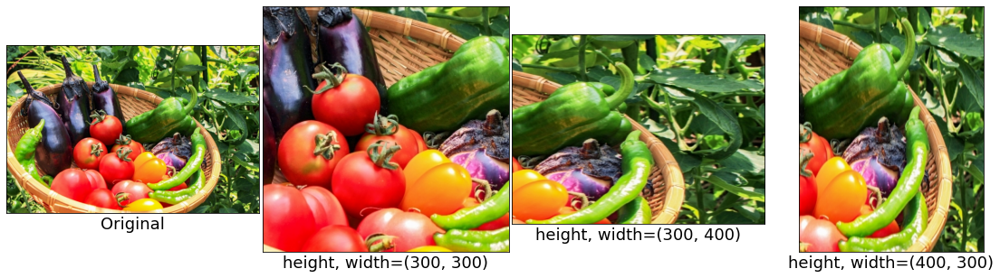

In [20]:
aug = []
n = 3
param1 = (300, 300)
param2 = (300, 400)
param3 = (400, 300)
aug.append(A.Compose([A.RandomSizedCrop(min_max_height=(300,300), height=param1[0], width=param1[1], p=1)]))
aug.append(A.Compose([A.RandomSizedCrop(min_max_height=(300,300), height=param2[0], width=param2[1], p=1)]))
aug.append(A.Compose([A.RandomSizedCrop(min_max_height=(300,300), height=param3[0], width=param3[1], p=1)]))
aug_img = [aug[i](image=img) for i in range(n)]

fig, ax = plt.subplots(1, 1+n, figsize=(5+5*n, 5))
plt.subplots_adjust(wspace=0)
plt.rcParams["font.size"] = 18
[ax[i].tick_params(bottom=False, left=False, right=False, top=False, labelbottom=False, labelleft=False, labelright=False, labeltop=False) for i in range(1+n)]

ax[0].set_xlabel("Original")
ax[1].set_xlabel("height, width={}".format(param1))
ax[2].set_xlabel("height, width={}".format(param2))
ax[3].set_xlabel("height, width={}".format(param3))

ax[0].imshow(img)
[ax[i+1].imshow(aug_img[i]['image']) for i in range(n)]

## RandomResizedCrop
### Torchvision’s variant of crop a random part of the input and rescale it to some size.
### ランダムに切り取り、特定の大きさにリスケールする（Torchvisionのバリアント）
* height (int) – height after crop and resize.
 - リサイズ後の高さ
* width (int) – width after crop and resize.
 - リサイズ後の幅
* scale ((float, float)) – range of size of the origin size cropped. Default: (0.08, 1.0).
 - クロップする領域のサイズの範囲
* ratio ((float, float)) – range of aspect ratio of the origin aspect ratio cropped. Default: (0.75, 1.3333333333333333).
 - クロップする領域のアスペクト比の範囲

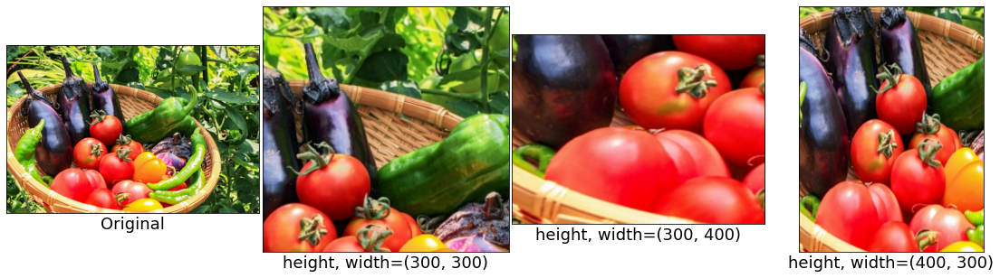

In [21]:
aug = []
n = 3
param1 = (300, 300)
param2 = (300, 400)
param3 = (400, 300)
aug.append(A.Compose([A.RandomResizedCrop(height=param1[0], width=param1[1], p=1)]))
aug.append(A.Compose([A.RandomResizedCrop(height=param2[0], width=param2[1], p=1)]))
aug.append(A.Compose([A.RandomResizedCrop(height=param3[0], width=param3[1], p=1)]))
aug_img = [aug[i](image=img) for i in range(n)]

fig, ax = plt.subplots(1, 1+n, figsize=(5+5*n, 5))
plt.subplots_adjust(wspace=0)
plt.rcParams["font.size"] = 18
[ax[i].tick_params(bottom=False, left=False, right=False, top=False, labelbottom=False, labelleft=False, labelright=False, labeltop=False) for i in range(1+n)]

ax[0].set_xlabel("Original")
ax[1].set_xlabel("height, width={}".format(param1))
ax[2].set_xlabel("height, width={}".format(param2))
ax[3].set_xlabel("height, width={}".format(param3))

ax[0].imshow(img)
[ax[i+1].imshow(aug_img[i]['image']) for i in range(n)]

## Rotate
### Rotate the input by an angle selected randomly from the uniform distribution.
### ランダムな角度で回転させる
* limit: range from which a random angle is picked. If limit is a single int an angle is picked from (-limit, limit). Default: (-90, 90)
 * 角度の範囲、単一数値の場合は(-limit, limit)

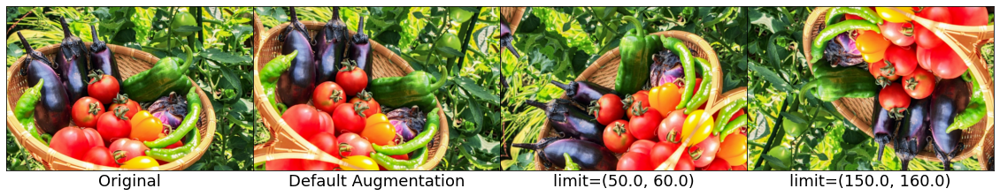

In [22]:
aug = []
n = 3
param1 = (50.0, 60.0)
param2 = (150.0, 160.0)
aug.append(A.Compose([A.Rotate(p=1)]))
aug.append(A.Compose([A.Rotate(limit=param1, p=1)]))
aug.append(A.Compose([A.Rotate(limit=param2, p=1)]))
aug_img = [aug[i](image=img) for i in range(n)]

fig, ax = plt.subplots(1, 1+n, figsize=(5+5*n, 5))
plt.subplots_adjust(wspace=0)
plt.rcParams["font.size"] = 18
[ax[i].tick_params(bottom=False, left=False, right=False, top=False, labelbottom=False, labelleft=False, labelright=False, labeltop=False) for i in range(1+n)]

ax[0].set_xlabel("Original")
ax[1].set_xlabel("Default Augmentation")
ax[2].set_xlabel("limit={}".format(param1))
ax[3].set_xlabel("limit={}".format(param2))

ax[0].imshow(img)
[ax[i+1].imshow(aug_img[i]['image']) for i in range(n)]

## RandomScale
### Randomly resize the input. Output image size is different from the input image size.
### 画像サイズをランダムに変更する
* scale_limit ((float, float) or float) – scaling factor range. If scale_limit is a single float value, the range will be (1 - scale_limit, 1 + scale_limit). Default: (0.9, 1.1).
 - 拡大縮小率の範囲 (0が変化なしなので注意)

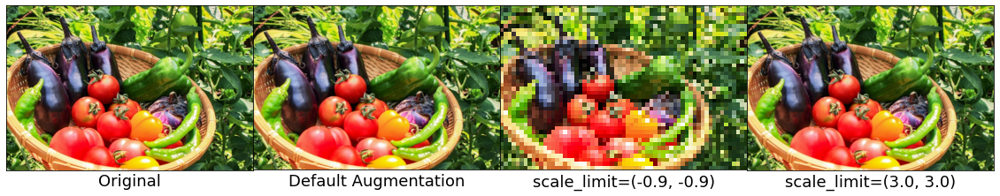

In [23]:
aug = []
n = 3
param1 = (-0.9, -0.9)
param2 = (3.0, 3.0)
aug.append(A.Compose([A.RandomScale(p=1)]))
aug.append(A.Compose([A.RandomScale(scale_limit=param1, p=1)]))
aug.append(A.Compose([A.RandomScale(scale_limit=param2, p=1)]))
aug_img = [aug[i](image=img) for i in range(n)]

fig, ax = plt.subplots(1, 1+n, figsize=(5+5*n, 5))
plt.subplots_adjust(wspace=0)
plt.rcParams["font.size"] = 18
[ax[i].tick_params(bottom=False, left=False, right=False, top=False, labelbottom=False, labelleft=False, labelright=False, labeltop=False) for i in range(1+n)]

ax[0].set_xlabel("Original")
ax[1].set_xlabel("Default Augmentation")
ax[2].set_xlabel("scale_limit={}".format(param1))
ax[3].set_xlabel("scale_limit={}".format(param2))

ax[0].imshow(img)
[ax[i+1].imshow(aug_img[i]['image']) for i in range(n)]

※一番右は同じサイズでプレビューされているので見た目にはわからないが元の画像サイズが変わっている

## RandomRotate90
### Randomly rotate the input by 90 degrees zero or more times.
### ランダムに90°単位で回転させる

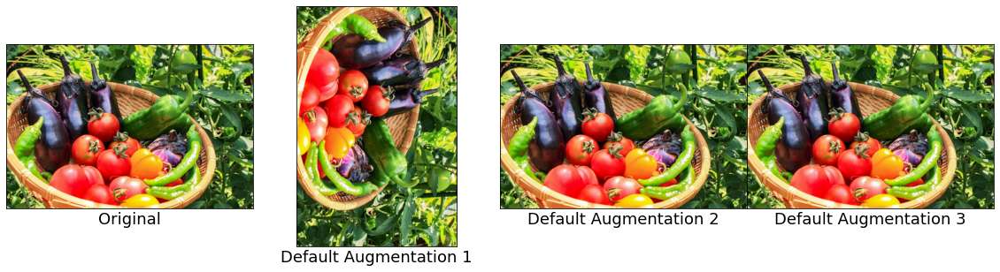

In [24]:
aug = []
n = 3
aug.append(A.Compose([A.RandomRotate90(p=1)]))
aug.append(A.Compose([A.RandomRotate90(p=1)]))
aug.append(A.Compose([A.RandomRotate90(p=1)]))
aug_img = [aug[i](image=img) for i in range(n)]

fig, ax = plt.subplots(1, 1+n, figsize=(5+5*n, 5))
plt.subplots_adjust(wspace=0)
plt.rcParams["font.size"] = 18
[ax[i].tick_params(bottom=False, left=False, right=False, top=False, labelbottom=False, labelleft=False, labelright=False, labeltop=False) for i in range(1+n)]

ax[0].set_xlabel("Original")
ax[1].set_xlabel("Default Augmentation 1")
ax[2].set_xlabel("Default Augmentation 2")
ax[3].set_xlabel("Default Augmentation 3")

ax[0].imshow(img)
[ax[i+1].imshow(aug_img[i]['image']) for i in range(n)]

## Transpose
### Transpose the input by swapping rows and columns.
### 行と列を入れ替えて転置

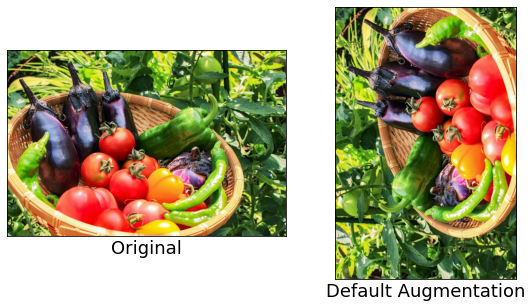

In [25]:
aug = []
n = 1
aug.append(A.Compose([A.Transpose(p=1)]))
aug_img = [aug[i](image=img) for i in range(n)]

fig, ax = plt.subplots(1, 1+n, figsize=(5+5*n, 5))
plt.subplots_adjust(wspace=0)
plt.rcParams["font.size"] = 18
[ax[i].tick_params(bottom=False, left=False, right=False, top=False, labelbottom=False, labelleft=False, labelright=False, labeltop=False) for i in range(1+n)]

ax[0].set_xlabel("Original")
ax[1].set_xlabel("Default Augmentation")

ax[0].imshow(img)
[ax[i+1].imshow(aug_img[i]['image']) for i in range(n)]

# 高度幾何変換系 (Affine, Distortion)

## ShiftScaleRotate
### Randomly apply affine transforms: translate, scale and rotate the input.
### ランダムにアフィン変換を適用する（平行移動、拡大縮小、回転）
* shift_limit: shift factor range for both height and width. If shift_limit is a single float value, the range will be (-shift_limit, shift_limit). Absolute values for lower and upper bounds should lie in range [0, 1]. Default: (-0.0625, 0.0625).
 * 平行移動の範囲
* scale_limit: scaling factor range. If scale_limit is a single float value, the range will be (-scale_limit, scale_limit). Default: (-0.1, 0.1).
 * 拡大縮小率の範囲 (0が変化なしなので注意)
* rotate_limit: rotation range. If rotate_limit is a single int value, the range will be (-rotate_limit, rotate_limit). Default: (-45, 45).
 * 回転の範囲

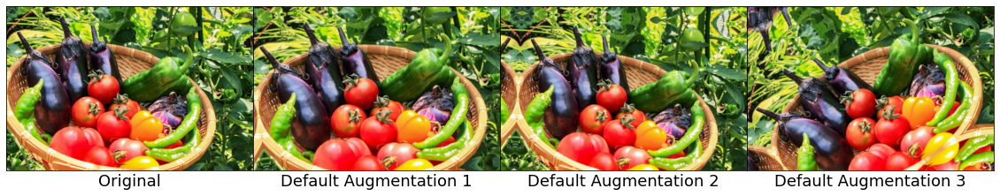

In [26]:
aug = []
n = 3
aug.append(A.Compose([A.ShiftScaleRotate(p=1)]))
aug.append(A.Compose([A.ShiftScaleRotate(p=1)]))
aug.append(A.Compose([A.ShiftScaleRotate(p=1)]))
aug_img = [aug[i](image=img) for i in range(n)]

fig, ax = plt.subplots(1, 1+n, figsize=(5+5*n, 5))
plt.subplots_adjust(wspace=0)
plt.rcParams["font.size"] = 18
[ax[i].tick_params(bottom=False, left=False, right=False, top=False, labelbottom=False, labelleft=False, labelright=False, labeltop=False) for i in range(1+n)]

ax[0].set_xlabel("Original")
ax[1].set_xlabel("Default Augmentation 1")
ax[2].set_xlabel("Default Augmentation 2")
ax[3].set_xlabel("Default Augmentation 3")

ax[0].imshow(img)
[ax[i+1].imshow(aug_img[i]['image']) for i in range(n)]

## OpticalDistortion
### 光学的な歪みを再現する
* distort_limit (float, (float, float)) – If distort_limit is a single float, the range will be (-distort_limit, distort_limit). Default: (-0.05, 0.05).
 * 歪みの範囲
* shift_limit (float, (float, float))) – If shift_limit is a single float, the range will be (-shift_limit, shift_limit). Default: (-0.05, 0.05).
 * シフトする範囲

Bounding BoxとKeypointsには適用できない

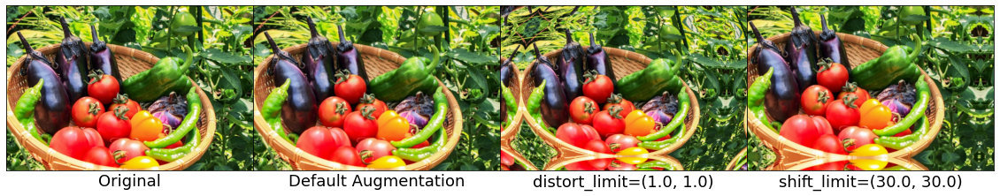

In [27]:
aug = []
n = 3
param1 = (1.0, 1.0)
param2 = (30.0, 30.0)
aug.append(A.Compose([A.OpticalDistortion(p=1)]))
aug.append(A.Compose([A.OpticalDistortion(distort_limit=param1, p=1)]))
aug.append(A.Compose([A.OpticalDistortion(shift_limit=param2, p=1)]))
aug_img = [aug[i](image=img) for i in range(n)]

fig, ax = plt.subplots(1, 1+n, figsize=(5+5*n, 5))
plt.subplots_adjust(wspace=0)
plt.rcParams["font.size"] = 18
[ax[i].tick_params(bottom=False, left=False, right=False, top=False, labelbottom=False, labelleft=False, labelright=False, labeltop=False) for i in range(1+n)]

ax[0].set_xlabel("Original")
ax[1].set_xlabel("Default Augmentation")
ax[2].set_xlabel("distort_limit={}".format(param1))
ax[3].set_xlabel("shift_limit={}".format(param2))

ax[0].imshow(img)
[ax[i+1].imshow(aug_img[i]['image']) for i in range(n)]

## GridDistortion
### Grid歪みを再現する
* num_steps (int) – count of grid cells on each side. Default: 5.
 * 各辺のグリッドセルの数を指定
* distort_limit (float, (float, float)) – If distort_limit is a single float, the range will be (-distort_limit, distort_limit). Default: (-0.03, 0.03).
 * 歪みの範囲

Bounding BoxとKeypointsには適用できない

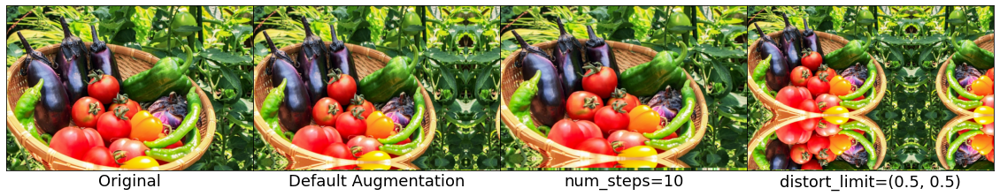

In [28]:
aug = []
n = 3
param1 = 10
param2 = (0.5, 0.5)
aug.append(A.Compose([A.GridDistortion(p=1)]))
aug.append(A.Compose([A.GridDistortion(num_steps=param1, p=1)]))
aug.append(A.Compose([A.GridDistortion(distort_limit=param2, p=1)]))
aug_img = [aug[i](image=img) for i in range(n)]

fig, ax = plt.subplots(1, 1+n, figsize=(5+5*n, 5))
plt.subplots_adjust(wspace=0)
plt.rcParams["font.size"] = 18
[ax[i].tick_params(bottom=False, left=False, right=False, top=False, labelbottom=False, labelleft=False, labelright=False, labeltop=False) for i in range(1+n)]

ax[0].set_xlabel("Original")
ax[1].set_xlabel("Default Augmentation")
ax[2].set_xlabel("num_steps={}".format(param1))
ax[3].set_xlabel("distort_limit={}".format(param2))

ax[0].imshow(img)
[ax[i+1].imshow(aug_img[i]['image']) for i in range(n)]

## ElasticTransform
### Elastic deformation of images as described in [Simard2003] (with modifications). 
### 弾性変形
* alpha (float) – Parameter. Default: 1.
 * 変形パラメータ
* sigma (float) – Gaussian filter parameter. Default: 50.
 * ガウシアンフィルタパラメータ
* alpha_affine (float) – The range will be (-alpha_affine, alpha_affine). Default: 50.
 * alpha_affineの範囲

Bounding BoxとKeypointsには適用できない

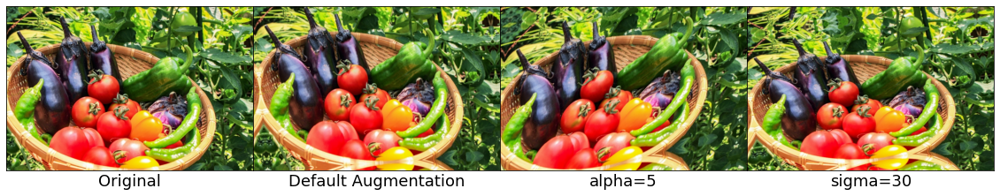

In [29]:
aug = []
n = 3
param1 = 5
param2 = 30
aug.append(A.Compose([A.ElasticTransform(p=1)]))
aug.append(A.Compose([A.ElasticTransform(alpha=param1, p=1)]))
aug.append(A.Compose([A.ElasticTransform(sigma=param2, p=1)]))
aug_img = [aug[i](image=img) for i in range(n)]

fig, ax = plt.subplots(1, 1+n, figsize=(5+5*n, 5))
plt.subplots_adjust(wspace=0)
plt.rcParams["font.size"] = 18
[ax[i].tick_params(bottom=False, left=False, right=False, top=False, labelbottom=False, labelleft=False, labelright=False, labeltop=False) for i in range(1+n)]

ax[0].set_xlabel("Original")
ax[1].set_xlabel("Default Augmentation")
ax[2].set_xlabel("alpha={}".format(param1))
ax[3].set_xlabel("sigma={}".format(param2))

ax[0].imshow(img)
[ax[i+1].imshow(aug_img[i]['image']) for i in range(n)]

## RandomGridShuffle
### Random shuffle grid’s cells on image.
### ランダムにグリッドのセルをシャッフルする
* grid ((int, int)) – size of grid for splitting image. Default: (3,3).
 * 画像を分割するグリッドのサイズ
 
Bounding BoxとKeypointsには適用できない

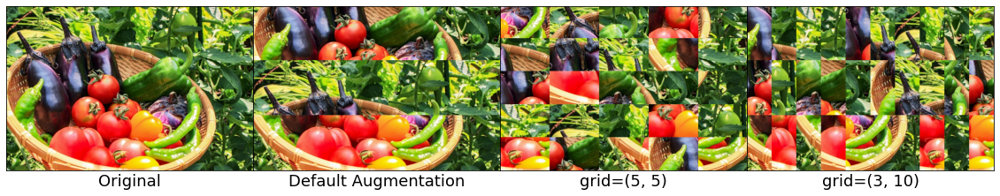

In [30]:
aug = []
n = 3
param1 = (5, 5)
param2 = (3, 10)
aug.append(A.Compose([A.RandomGridShuffle(p=1)]))
aug.append(A.Compose([A.RandomGridShuffle(grid=param1, p=1)]))
aug.append(A.Compose([A.RandomGridShuffle(grid=param2, p=1)]))
aug_img = [aug[i](image=img) for i in range(n)]

fig, ax = plt.subplots(1, 1+n, figsize=(5+5*n, 5))
plt.subplots_adjust(wspace=0)
plt.rcParams["font.size"] = 18
[ax[i].tick_params(bottom=False, left=False, right=False, top=False, labelbottom=False, labelleft=False, labelright=False, labeltop=False) for i in range(1+n)]

ax[0].set_xlabel("Original")
ax[1].set_xlabel("Default Augmentation")
ax[2].set_xlabel("grid={}".format(param1))
ax[3].set_xlabel("grid={}".format(param2))

ax[0].imshow(img)
[ax[i+1].imshow(aug_img[i]['image']) for i in range(n)]

# 色いじる系

## HueSaturationValue
### Randomly change hue, saturation and value of the input image.
### ランダムに色相、彩度、輝度を変える
* hue_shift_limit ((int, int) or int) – range for changing hue. If hue_shift_limit is a single int, the range will be (-hue_shift_limit, hue_shift_limit). Default: (-20, 20).
 * 色相の範囲
* sat_shift_limit ((int, int) or int) – range for changing saturation. If sat_shift_limit is a single int, the range will be (-sat_shift_limit, sat_shift_limit). Default: (-30, 30).
 * 彩度の範囲
* val_shift_limit ((int, int) or int) – range for changing value. If val_shift_limit is a single int, the range will be (-val_shift_limit, val_shift_limit). Default: (-20, 20).
 * 輝度の範囲

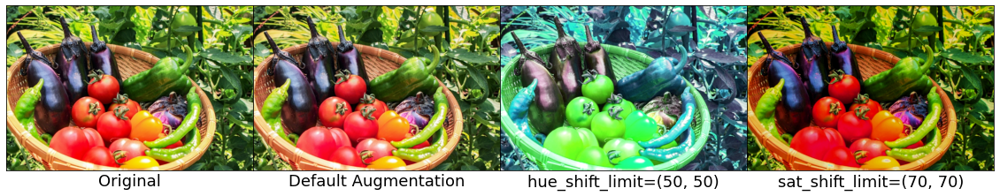

In [31]:
aug = []
n = 3
param1 = (50, 50)
param2 = (70, 70)
aug.append(A.Compose([A.HueSaturationValue(p=1)]))
aug.append(A.Compose([A.HueSaturationValue(hue_shift_limit=param1, p=1)]))
aug.append(A.Compose([A.HueSaturationValue(sat_shift_limit=param2, p=1)]))
aug_img = [aug[i](image=img) for i in range(n)]

fig, ax = plt.subplots(1, 1+n, figsize=(5+5*n, 5))
plt.subplots_adjust(wspace=0)
plt.rcParams["font.size"] = 18
[ax[i].tick_params(bottom=False, left=False, right=False, top=False, labelbottom=False, labelleft=False, labelright=False, labeltop=False) for i in range(1+n)]

ax[0].set_xlabel("Original")
ax[1].set_xlabel("Default Augmentation")
ax[2].set_xlabel("hue_shift_limit={}".format(param1))
ax[3].set_xlabel("sat_shift_limit={}".format(param2))

ax[0].imshow(img)
[ax[i+1].imshow(aug_img[i]['image']) for i in range(n)]

## RGBShift
### Randomly shift values for each channel of the input RGB image.
### ランダムにRGBの各チャンネルの値を変える
* r_shift_limit ((int, int) or int) – range for changing values for the red channel. If r_shift_limit is a single int, the range will be (-r_shift_limit, r_shift_limit). Default: (-20, 20).
 * Redチャネルの変化範囲
* g_shift_limit ((int, int) or int) – range for changing values for the green channel. If g_shift_limit is a single int, the range will be (-g_shift_limit, g_shift_limit). Default: (-20, 20).
 * Greenチャネルの変化範囲
* b_shift_limit ((int, int) or int) – range for changing values for the blue channel. If b_shift_limit is a single int, the range will be (-b_shift_limit, b_shift_limit). Default: (-20, 20).
 * Blueチャネルの変化範囲

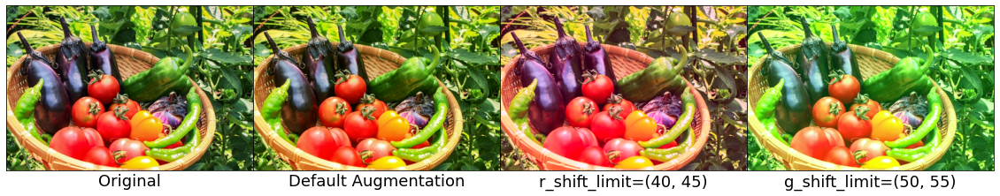

In [32]:
aug = []
n = 3
param1 = (40, 45)
param2 = (50, 55)
aug.append(A.Compose([A.RGBShift(p=1)]))
aug.append(A.Compose([A.RGBShift(r_shift_limit=param1, p=1)]))
aug.append(A.Compose([A.RGBShift(g_shift_limit=param2, p=1)]))
aug_img = [aug[i](image=img) for i in range(n)]

fig, ax = plt.subplots(1, 1+n, figsize=(5+5*n, 5))
plt.subplots_adjust(wspace=0)
plt.rcParams["font.size"] = 18
[ax[i].tick_params(bottom=False, left=False, right=False, top=False, labelbottom=False, labelleft=False, labelright=False, labeltop=False) for i in range(1+n)]

ax[0].set_xlabel("Original")
ax[1].set_xlabel("Default Augmentation")
ax[2].set_xlabel("r_shift_limit={}".format(param1))
ax[3].set_xlabel("g_shift_limit={}".format(param2))

ax[0].imshow(img)
[ax[i+1].imshow(aug_img[i]['image']) for i in range(n)]

## ChannelShuffle
### Randomly rearrange channels of the input RGB image.
### RGBのチャンネルをランダムに並べ替える

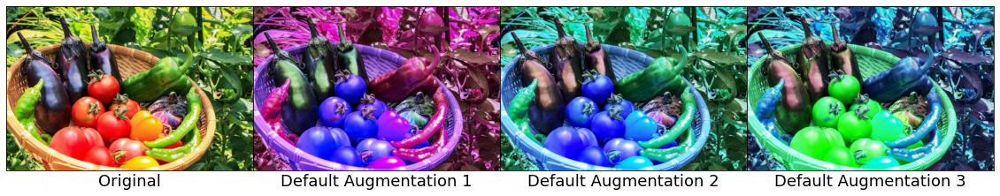

In [33]:
aug = []
n = 3
aug.append(A.Compose([A.ChannelShuffle(p=1)]))
aug.append(A.Compose([A.ChannelShuffle(p=1)]))
aug.append(A.Compose([A.ChannelShuffle(p=1)]))
aug_img = [aug[i](image=img) for i in range(n)]

fig, ax = plt.subplots(1, 1+n, figsize=(5+5*n, 5))
plt.subplots_adjust(wspace=0)
plt.rcParams["font.size"] = 18
[ax[i].tick_params(bottom=False, left=False, right=False, top=False, labelbottom=False, labelleft=False, labelright=False, labeltop=False) for i in range(1+n)]

ax[0].set_xlabel("Original")
ax[1].set_xlabel("Default Augmentation 1")
ax[2].set_xlabel("Default Augmentation 2")
ax[3].set_xlabel("Default Augmentation 3")

ax[0].imshow(img)
[ax[i+1].imshow(aug_img[i]['image']) for i in range(n)]

## ChannelDropout
### Randomly Drop Channels in the input Image.
### ランダムにチャンネルをドロップする
* channel_drop_range (int, int) – range from which we choose the number of channels to drop.
* fill_value (int, float) – pixel value for the dropped channel.

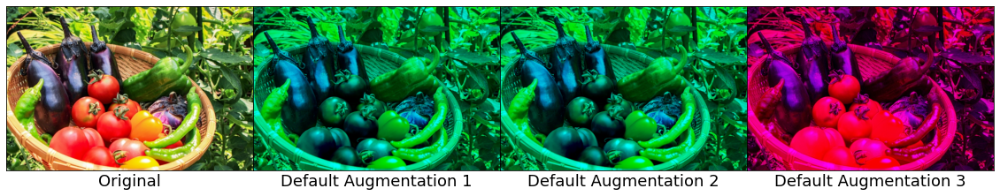

In [34]:
aug = []
n = 3
aug.append(A.Compose([A.ChannelDropout(p=1)]))
aug.append(A.Compose([A.ChannelDropout(p=1)]))
aug.append(A.Compose([A.ChannelDropout(p=1)]))
aug_img = [aug[i](image=img) for i in range(n)]

fig, ax = plt.subplots(1, 1+n, figsize=(5+5*n, 5))
plt.subplots_adjust(wspace=0)
plt.rcParams["font.size"] = 18
[ax[i].tick_params(bottom=False, left=False, right=False, top=False, labelbottom=False, labelleft=False, labelright=False, labeltop=False) for i in range(1+n)]

ax[0].set_xlabel("Original")
ax[1].set_xlabel("Default Augmentation 1")
ax[2].set_xlabel("Default Augmentation 2")
ax[3].set_xlabel("Default Augmentation 3")

ax[0].imshow(img)
[ax[i+1].imshow(aug_img[i]['image']) for i in range(n)]

## Posterize
### Reduce the number of bits for each color channel.
### 各色チャンネルのビット数を減らす
* num_bits ((int, int) – or list of ints [r, g, b], or list of ints [[r1, r1], [g1, g2], [b1, b2]]): number of high bits. If num_bits is a single value, the range will be [num_bits, num_bits]. Must be in range [0, 8]. Default: 4.

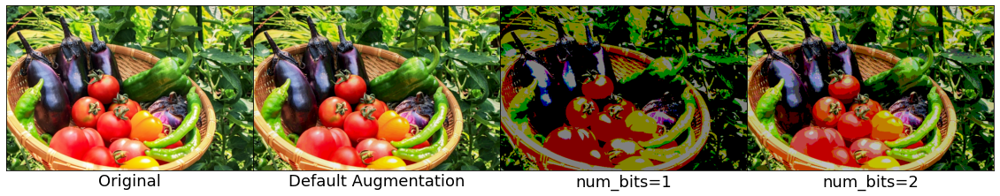

In [35]:
aug = []
n = 3
param1 = 1
param2 = 2
aug.append(A.Compose([A.Posterize(p=1)]))
aug.append(A.Compose([A.Posterize(num_bits=param1, p=1)]))
aug.append(A.Compose([A.Posterize(num_bits=param2, p=1)]))
aug_img = [aug[i](image=img) for i in range(n)]

fig, ax = plt.subplots(1, 1+n, figsize=(5+5*n, 5))
plt.subplots_adjust(wspace=0)
plt.rcParams["font.size"] = 18
[ax[i].tick_params(bottom=False, left=False, right=False, top=False, labelbottom=False, labelleft=False, labelright=False, labeltop=False) for i in range(1+n)]

ax[0].set_xlabel("Original")
ax[1].set_xlabel("Default Augmentation")
ax[2].set_xlabel("num_bits={}".format(param1))
ax[3].set_xlabel("num_bits={}".format(param2))

ax[0].imshow(img)
[ax[i+1].imshow(aug_img[i]['image']) for i in range(n)]

## ToGray
### Convert the input RGB image to grayscale. If the mean pixel value for the resulting image is greater than 127, invert the resulting grayscale image.
### RGB画像をグレースケールに変換する

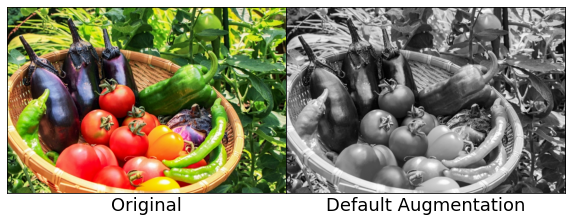

In [36]:
aug = []
n = 1
aug.append(A.Compose([A.ToGray(p=1)]))
aug_img = [aug[i](image=img) for i in range(n)]

fig, ax = plt.subplots(1, 1+n, figsize=(5+5*n, 5))
plt.subplots_adjust(wspace=0)
plt.rcParams["font.size"] = 18
[ax[i].tick_params(bottom=False, left=False, right=False, top=False, labelbottom=False, labelleft=False, labelright=False, labeltop=False) for i in range(1+n)]

ax[0].set_xlabel("Original")
ax[1].set_xlabel("Default Augmentation")

ax[0].imshow(img)
[ax[i+1].imshow(aug_img[i]['image']) for i in range(n)]

## ToSepia
### Applies sepia filter to the input RGB image
### セピアフィルタを適用する

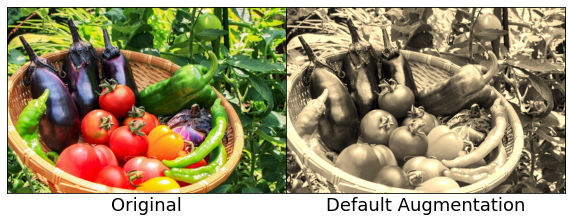

In [37]:
aug = []
n = 1
aug.append(A.Compose([A.ToSepia(p=1)]))
aug_img = [aug[i](image=img) for i in range(n)]

fig, ax = plt.subplots(1, 1+n, figsize=(5+5*n, 5))
plt.subplots_adjust(wspace=0)
plt.rcParams["font.size"] = 18
[ax[i].tick_params(bottom=False, left=False, right=False, top=False, labelbottom=False, labelleft=False, labelright=False, labeltop=False) for i in range(1+n)]

ax[0].set_xlabel("Original")
ax[1].set_xlabel("Default Augmentation")

ax[0].imshow(img)
[ax[i+1].imshow(aug_img[i]['image']) for i in range(n)]

# 輝度やコントラストいじる系

## InvertImg
### Invert the input image by subtracting pixel values from 255.
### 画素値を反転させる

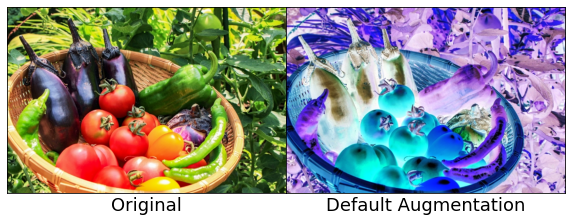

In [38]:
aug = []
n = 1
aug.append(A.Compose([A.InvertImg(p=1)]))
aug_img = [aug[i](image=img) for i in range(n)]

fig, ax = plt.subplots(1, 1+n, figsize=(5+5*n, 5))
plt.subplots_adjust(wspace=0)
plt.rcParams["font.size"] = 18
[ax[i].tick_params(bottom=False, left=False, right=False, top=False, labelbottom=False, labelleft=False, labelright=False, labeltop=False) for i in range(1+n)]

ax[0].set_xlabel("Original")
ax[1].set_xlabel("Default Augmentation")

ax[0].imshow(img)
[ax[i+1].imshow(aug_img[i]['image']) for i in range(n)]

## Normalize
### Divide pixel values by 255 = 2**8 - 1, subtract mean per channel and divide by std per channel.
### 画素値を255で除算→チャンネルごとの平均値を減算→チャンネルごとの標準偏差で除算（平均値と標準偏差は単なるパラメータに過ぎず内部で暗黙に計算されない）
* mean: mean values (平均値), Dafault: (0.485, 0.456, 0.406)
* std: std values (標準偏差), Dafault: (0.229, 0.224, 0.225)
* max_pixel_value: maximum possible pixel value (画素値の最大値), Dafault: 255.0


In [39]:
r_mean, g_mean, b_mean = img[0].flatten().mean()/255.0, img[1].flatten().mean()/255.0, img[2].flatten().mean()/255.0
r_std, g_std, b_std = np.std(img[0])/255.0, np.std(img[1])/255.0, np.std(img[2])/255.0
print('mean:', r_mean, g_mean, b_mean)
print('std:', r_std, g_std, b_std)

mean: 0.4031107026143791 0.4010947712418301 0.3981781045751634
std: 0.2605155335122379 0.2578258395044395 0.2580448773340305


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


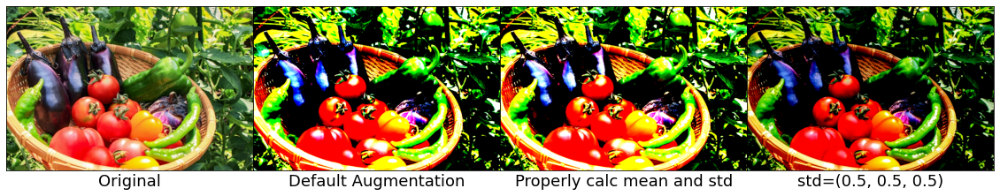

In [40]:
aug = []
n = 3
param1_1 = r_mean, g_mean, b_mean
param1_2 = r_std, g_std, b_std
param2 = (0.5, 0.5, 0.5)
aug.append(A.Compose([A.Normalize(p=1)]))
aug.append(A.Compose([A.Normalize(mean=param1_1, std=param1_2, p=1)]))
aug.append(A.Compose([A.Normalize(std=param2, p=1)]))
aug_img = [aug[i](image=img) for i in range(n)]

fig, ax = plt.subplots(1, 1+n, figsize=(5+5*n, 5))
plt.subplots_adjust(wspace=0)
plt.rcParams["font.size"] = 18
[ax[i].tick_params(bottom=False, left=False, right=False, top=False, labelbottom=False, labelleft=False, labelright=False, labeltop=False) for i in range(1+n)]

ax[0].set_xlabel("Original")
ax[1].set_xlabel("Default Augmentation")
ax[2].set_xlabel("Properly calc mean and std")
ax[3].set_xlabel("std={}".format(param2))

ax[0].imshow(img)
[ax[i+1].imshow(aug_img[i]['image']) for i in range(n)]

## RandomGamma
### Randomly apply a gamma.
### ランダムにガンマ変換をかける
* gamma_limit:  If gamma_limit is a single float value, the range will be (-gamma_limit, gamma_limit). (1つの場合、範囲は(-gamma_limit, gamma_limit)となる), Default: (80, 120).

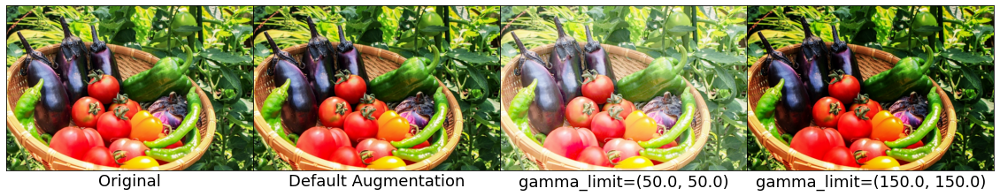

In [41]:
aug = []
n = 3
param1 = (50.0, 50.0)
param2 = (150.0, 150.0)
aug.append(A.Compose([A.RandomGamma(p=1)]))
aug.append(A.Compose([A.RandomGamma(gamma_limit=param1, p=1)]))
aug.append(A.Compose([A.RandomGamma(gamma_limit=param2, p=1)]))
aug_img = [aug[i](image=img) for i in range(n)]

fig, ax = plt.subplots(1, 1+n, figsize=(5+5*n, 5))
plt.subplots_adjust(wspace=0)
plt.rcParams["font.size"] = 18
[ax[i].tick_params(bottom=False, left=False, right=False, top=False, labelbottom=False, labelleft=False, labelright=False, labeltop=False) for i in range(1+n)]

ax[0].set_xlabel("Original")
ax[1].set_xlabel("Default Augmentation")
ax[2].set_xlabel("gamma_limit={}".format(param1))
ax[3].set_xlabel("gamma_limit={}".format(param2))

ax[0].imshow(img)
[ax[i+1].imshow(aug_img[i]['image']) for i in range(n)]

## RandomBrightness
### Randomly change brightness of the input image.
### ランダムに明るさを変える
* limit ((float, float) or float) – factor range for changing brightness. If limit is a single float, the range will be (-limit, limit). Default: (-0.2, 0.2).
 * 明るさの変化範囲

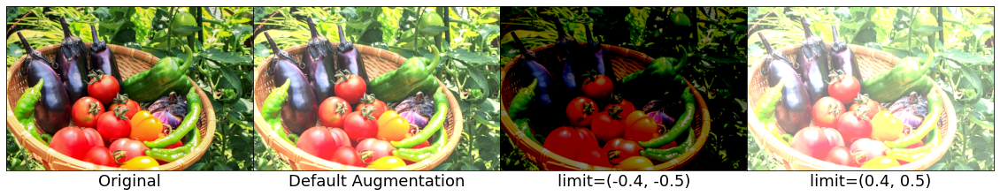

In [42]:
aug = []
n = 3
param1 = (-0.4, -0.5)
param2 = (0.4, 0.5)
aug.append(A.Compose([A.RandomBrightness(p=1)]))
aug.append(A.Compose([A.RandomBrightness(limit=param1, p=1)]))
aug.append(A.Compose([A.RandomBrightness(limit=param2, p=1)]))
aug_img = [aug[i](image=img) for i in range(n)]

fig, ax = plt.subplots(1, 1+n, figsize=(5+5*n, 5))
plt.subplots_adjust(wspace=0)
plt.rcParams["font.size"] = 18
[ax[i].tick_params(bottom=False, left=False, right=False, top=False, labelbottom=False, labelleft=False, labelright=False, labeltop=False) for i in range(1+n)]

ax[0].set_xlabel("Original")
ax[1].set_xlabel("Default Augmentation")
ax[2].set_xlabel("limit={}".format(param1))
ax[3].set_xlabel("limit={}".format(param2))

ax[0].imshow(img)
[ax[i+1].imshow(aug_img[i]['image']) for i in range(n)]

## RandomContrast
### Randomly change contrast of the input image.
### ランダムにコントラストを変える
* limit ((float, float) or float) – factor range for changing contrast. If limit is a single float, the range will be (-limit, limit). Default: (-0.2, 0.2).
 * コントラストの変化範囲

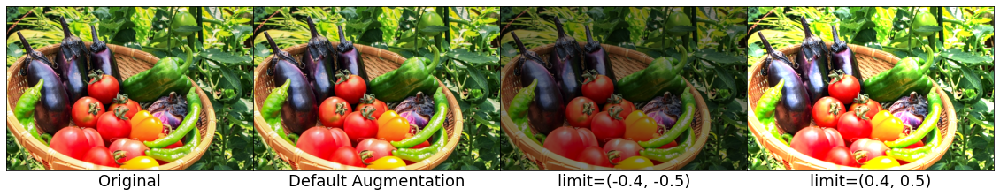

In [43]:
aug = []
n = 3
param1 = (-0.4, -0.5)
param2 = (0.4, 0.5)
aug.append(A.Compose([A.RandomContrast(p=1)]))
aug.append(A.Compose([A.RandomContrast(limit=param1, p=1)]))
aug.append(A.Compose([A.RandomContrast(limit=param2, p=1)]))
aug_img = [aug[i](image=img) for i in range(n)]

fig, ax = plt.subplots(1, 1+n, figsize=(5+5*n, 5))
plt.subplots_adjust(wspace=0)
plt.rcParams["font.size"] = 18
[ax[i].tick_params(bottom=False, left=False, right=False, top=False, labelbottom=False, labelleft=False, labelright=False, labeltop=False) for i in range(1+n)]

ax[0].set_xlabel("Original")
ax[1].set_xlabel("Default Augmentation")
ax[2].set_xlabel("limit={}".format(param1))
ax[3].set_xlabel("limit={}".format(param2))

ax[0].imshow(img)
[ax[i+1].imshow(aug_img[i]['image']) for i in range(n)]

## RandomBrightnessContrast
### Randomly change brightness and contrast of the input image.
### ランダムに明るさとコントラストを変える
* brightness_limit ((float, float) or float) – factor range for changing brightness. If limit is a single float, the range will be (-limit, limit). Default: (-0.2, 0.2).
 - 明るさの変化範囲
* contrast_limit ((float, float) or float) – factor range for changing contrast. If limit is a single float, the range will be (-limit, limit). Default: (-0.2, 0.2).
 - コントラストの変化範囲
* brightness_by_max (Boolean) – If True adjust contrast by image dtype maximum, else adjust contrast by image mean. Default: True.
 - コントラストの調整方法

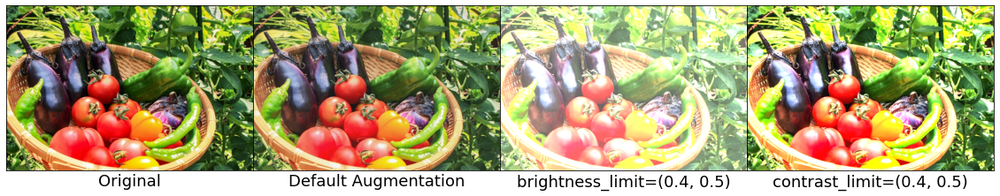

In [44]:
aug = []
n = 3
param1 = (0.4, 0.5)
param2 = (0.4, 0.5)
aug.append(A.Compose([A.RandomBrightnessContrast(p=1)]))
aug.append(A.Compose([A.RandomBrightnessContrast(brightness_limit=param1, p=1)]))
aug.append(A.Compose([A.RandomBrightnessContrast(contrast_limit=param2, p=1)]))
aug_img = [aug[i](image=img) for i in range(n)]

fig, ax = plt.subplots(1, 1+n, figsize=(5+5*n, 5))
plt.subplots_adjust(wspace=0)
plt.rcParams["font.size"] = 18
[ax[i].tick_params(bottom=False, left=False, right=False, top=False, labelbottom=False, labelleft=False, labelright=False, labeltop=False) for i in range(1+n)]

ax[0].set_xlabel("Original")
ax[1].set_xlabel("Default Augmentation")
ax[2].set_xlabel("brightness_limit={}".format(param1))
ax[3].set_xlabel("contrast_limit={}".format(param2))

ax[0].imshow(img)
[ax[i+1].imshow(aug_img[i]['image']) for i in range(n)]

## CLAHE
### Apply Contrast Limited Adaptive Histogram Equalization to the input image.
### コントラスト制限適応型ヒストグラム均等化
* clip_limit (float or (float, float)) – upper threshold value for contrast limiting. If clip_limit is a single float value, the range will be (1, clip_limit). Default: (1, 4).
 - コントラスト制限の上限閾値
* tile_grid_size ((int, int)) – size of grid for histogram equalization. Default: (8, 8).
 - ヒストグラム均等化のためのグリッドサイズ


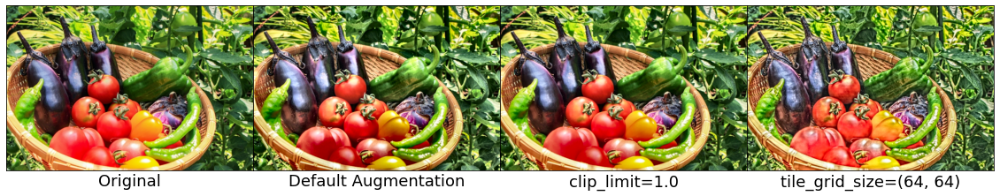

In [45]:
aug = []
n = 3
param1 = 1.0
param2 = (64, 64)
aug.append(A.Compose([A.CLAHE(p=1)]))
aug.append(A.Compose([A.CLAHE(clip_limit=param1, p=1)]))
aug.append(A.Compose([A.CLAHE(tile_grid_size=param2, p=1)]))
aug_img = [aug[i](image=img) for i in range(n)]

fig, ax = plt.subplots(1, 1+n, figsize=(5+5*n, 5))
plt.subplots_adjust(wspace=0)
plt.rcParams["font.size"] = 18
[ax[i].tick_params(bottom=False, left=False, right=False, top=False, labelbottom=False, labelleft=False, labelright=False, labeltop=False) for i in range(1+n)]

ax[0].set_xlabel("Original")
ax[1].set_xlabel("Default Augmentation")
ax[2].set_xlabel("clip_limit={}".format(param1))
ax[3].set_xlabel("tile_grid_size={}".format(param2))

ax[0].imshow(img)
[ax[i+1].imshow(aug_img[i]['image']) for i in range(n)]

## Solarize
### Invert all pixel values above a threshold.
### 閾値以上の画素値を反転させる（ソラリ）
* threshold ((int, int) or int, or (float, float) or float) – range for solarizing threshold. threshold is a single value, the range will be [threshold, threshold] Default: 128

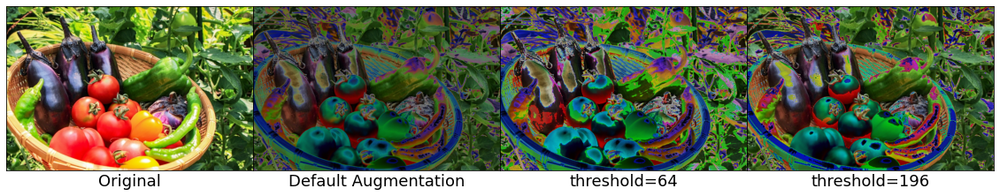

In [46]:
aug = []
n = 3
param1 = 64
param2 = 196
aug.append(A.Compose([A.Solarize(p=1)]))
aug.append(A.Compose([A.Solarize(threshold=param1, p=1)]))
aug.append(A.Compose([A.Solarize(threshold=param2, p=1)]))
aug_img = [aug[i](image=img) for i in range(n)]

fig, ax = plt.subplots(1, 1+n, figsize=(5+5*n, 5))
plt.subplots_adjust(wspace=0)
plt.rcParams["font.size"] = 18
[ax[i].tick_params(bottom=False, left=False, right=False, top=False, labelbottom=False, labelleft=False, labelright=False, labeltop=False) for i in range(1+n)]

ax[0].set_xlabel("Original")
ax[1].set_xlabel("Default Augmentation")
ax[2].set_xlabel("threshold={}".format(param1))
ax[3].set_xlabel("threshold={}".format(param2))

ax[0].imshow(img)
[ax[i+1].imshow(aug_img[i]['image']) for i in range(n)]

# Dropout系

## Cutout
### CoarseDropout of the square regions in the image.
### 矩形領域の粗いDropout
* num_holes (int) – number of regions to zero out. Defalt: 8.
 - ゼロに落とす領域数
* max_h_size (int) – maximum height of the hole. Defalt: 8.
 - 領域の最大高さ
* max_w_size (int) – maximum width of the hole. Defalt: 8.
 - 領域の最大幅
* fill_value (int, float, lisf of int, list of float). Defalt: 0.
 - 落とした領域の画素値

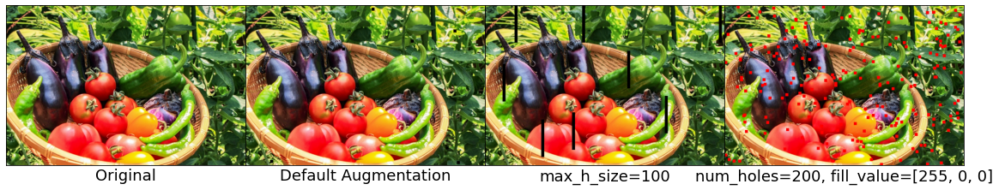

In [47]:
aug = []
n = 3
param1 = 100
param2 = (200, [255,0,0])
aug.append(A.Compose([A.Cutout(p=1)]))
aug.append(A.Compose([A.Cutout(max_h_size=param1, p=1)]))
aug.append(A.Compose([A.Cutout(num_holes=param2[0], fill_value=param2[1], p=1)]))
aug_img = [aug[i](image=img) for i in range(n)]

fig, ax = plt.subplots(1, 1+n, figsize=(5+5*n, 5))
plt.subplots_adjust(wspace=0)
plt.rcParams["font.size"] = 18
[ax[i].tick_params(bottom=False, left=False, right=False, top=False, labelbottom=False, labelleft=False, labelright=False, labeltop=False) for i in range(1+n)]

ax[0].set_xlabel("Original")
ax[1].set_xlabel("Default Augmentation")
ax[2].set_xlabel("max_h_size={}".format(param1))
ax[3].set_xlabel("num_holes={}, fill_value={}".format(param2[0], param2[1]))

ax[0].imshow(img)
[ax[i+1].imshow(aug_img[i]['image']) for i in range(n)]

## CoarseDropout
### CoarseDropout of the rectangular regions in the image.
### 矩形領域の粗いDropout（最小値も指定可能）
* max_holes (int) – Maximum number of regions to zero out..
 - ゼロに落とす領域数の最大数
* max_height (int) – Maximum height of the hole. Defalt: 8.
 - 領域の最大高さ
* max_width (int) – Maximum width of the hole. Defalt: 8.
 - 領域の最大幅
* min_holes (int) – Minimum number of regions to zero out. If None, min_holes is be set to max_holes. Default: None.
 - ゼロに落とす領域数の再小数
* min_height (int) – Minimum height of the hole. Default: None. If None, * min_height is set to max_height. Default: None.
 - 領域の最小高さ
* min_width – Minimum width of the hole. If None, min_height is set to max_width. Default: None.
 - 領域の最小幅
* fill_value (int, float, lisf of int, list of float). Defalt: 0.
 - 落とした領域の画素値

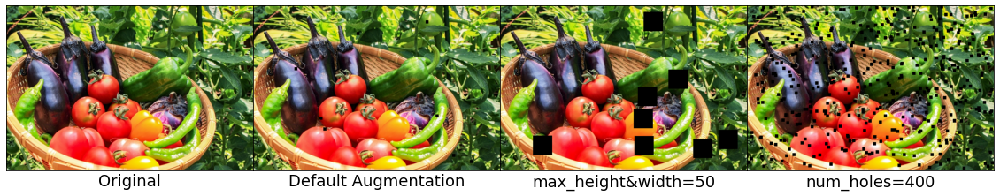

In [48]:
aug = []
n = 3
param1 = 50
param2 = (400, [0,255,0])
aug.append(A.Compose([A.CoarseDropout(p=1)]))
aug.append(A.Compose([A.CoarseDropout(max_height=param1, max_width=param1, p=1)]))
aug.append(A.Compose([A.CoarseDropout(max_holes=param2[0], p=1)]))
aug_img = [aug[i](image=img) for i in range(n)]

fig, ax = plt.subplots(1, 1+n, figsize=(5+5*n, 5))
plt.subplots_adjust(wspace=0)
plt.rcParams["font.size"] = 18
[ax[i].tick_params(bottom=False, left=False, right=False, top=False, labelbottom=False, labelleft=False, labelright=False, labeltop=False) for i in range(1+n)]

ax[0].set_xlabel("Original")
ax[1].set_xlabel("Default Augmentation")
ax[2].set_xlabel("max_height&width={}".format(param1))
ax[3].set_xlabel("num_holes={}".format(param2[0]))

ax[0].imshow(img)
[ax[i+1].imshow(aug_img[i]['image']) for i in range(n)]

# 天候変化・環境・光学再現系

## RandomSnow
### Bleach out some pixel values simulating snow.
### 雪をシミュレートする
* snow_point_lower (float) – lower_bond of the amount of snow. Should be in [0, 1] range. Default: 0.1.
 - 雪の下限値
* snow_point_upper (float) – upper_bond of the amount of snow. Should be in [0, 1] range. Default: 0.3.
 - 雪の上限値
* brightness_coeff (float) – larger number will lead to a more snow on the image. Should be >= 0. Default: 2.5.
 - 大きいと雪が多くなる

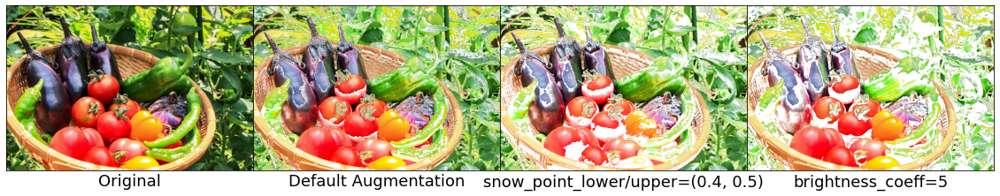

In [49]:
aug = []
n = 3
param1 = (0.4, 0.5)
param2 = 5
aug.append(A.Compose([A.RandomSnow(p=1)]))
aug.append(A.Compose([A.RandomSnow(snow_point_lower=param1[0], snow_point_upper=param1[1], p=1)]))
aug.append(A.Compose([A.RandomSnow(brightness_coeff=param2, p=1)]))
aug_img = [aug[i](image=img) for i in range(n)]

fig, ax = plt.subplots(1, 1+n, figsize=(5+5*n, 5))
plt.subplots_adjust(wspace=0)
plt.rcParams["font.size"] = 18
[ax[i].tick_params(bottom=False, left=False, right=False, top=False, labelbottom=False, labelleft=False, labelright=False, labeltop=False) for i in range(1+n)]

ax[0].set_xlabel("Original")
ax[1].set_xlabel("Default Augmentation")
ax[2].set_xlabel("snow_point_lower/upper={}".format(param1))
ax[3].set_xlabel("brightness_coeff={}".format(param2))

ax[0].imshow(img)
[ax[i+1].imshow(aug_img[i]['image']) for i in range(n)]

## RandomRain
### Adds rain effects.
### 雨のエフェクト
* slant_lower – should be in range [-20, 20]. Default: -10.
* slant_upper – should be in range [-20, 20]. Default: 10.
* drop_length – should be in range [0, 100]. Default: 20.
* drop_width – should be in range [1, 5]. Default: 1.
* drop_color (list of (r, g, b)) – rain lines color. Default: (200, 200, 200),.
 - 雨線の色
* blur_value (int) – rainy view are blurry. Default: 7.
 - 雨粒のブラー
* brightness_coefficient (float) – rainy days are usually shady. Should be in  range [0, 1]. Default: 0.7.
 - 明るさ
* rain_type – One of [None, “drizzle”, “heavy”, “torrestial”]. Default: None.
 - 雨のタイプ


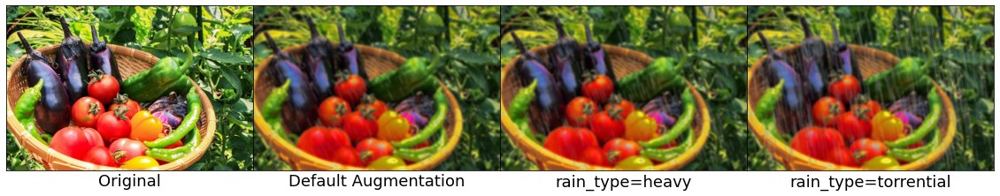

In [50]:
aug = []
n = 3
param1 = "heavy"
param2 = "torrential"
aug.append(A.Compose([A.RandomRain(p=1)]))
aug.append(A.Compose([A.RandomRain(rain_type=param1, p=1)]))
aug.append(A.Compose([A.RandomRain(rain_type=param2, p=1)]))
aug_img = [aug[i](image=img) for i in range(n)]

fig, ax = plt.subplots(1, 1+n, figsize=(5+5*n, 5))
plt.subplots_adjust(wspace=0)
plt.rcParams["font.size"] = 18
[ax[i].tick_params(bottom=False, left=False, right=False, top=False, labelbottom=False, labelleft=False, labelright=False, labeltop=False) for i in range(1+n)]

ax[0].set_xlabel("Original")
ax[1].set_xlabel("Default Augmentation")
ax[2].set_xlabel("rain_type={}".format(param1))
ax[3].set_xlabel("rain_type={}".format(param2))

ax[0].imshow(img)
[ax[i+1].imshow(aug_img[i]['image']) for i in range(n)]

## RandomFog
### Simulates fog for the image
### 霧をシミュレートする
* fog_coef_lower (float) – lower limit for fog intensity coefficient. Should be in [0, 1] range.
 - 霧の強度の下限
* fog_coef_upper (float) – upper limit for fog intensity coefficient. Should be in [0, 1] range.
 - 霧の強度の上限

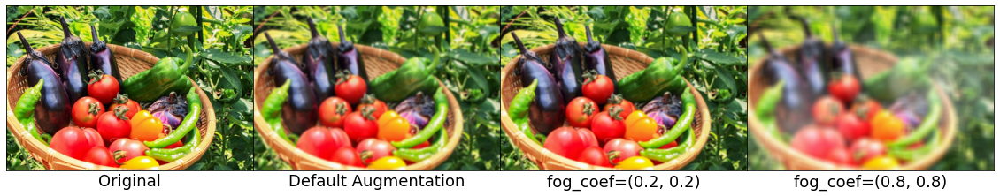

In [51]:
aug = []
n = 3
param1 = (0.2, 0.2)
param2 = (0.8, 0.8)
aug.append(A.Compose([A.RandomFog(p=1)]))
aug.append(A.Compose([A.RandomFog(fog_coef_lower=param1[0], fog_coef_upper=param1[1], p=1)]))
aug.append(A.Compose([A.RandomFog(fog_coef_lower=param2[0], fog_coef_upper=param2[1], p=1)]))
aug_img = [aug[i](image=img) for i in range(n)]

fig, ax = plt.subplots(1, 1+n, figsize=(5+5*n, 5))
plt.subplots_adjust(wspace=0)
plt.rcParams["font.size"] = 18
[ax[i].tick_params(bottom=False, left=False, right=False, top=False, labelbottom=False, labelleft=False, labelright=False, labeltop=False) for i in range(1+n)]

ax[0].set_xlabel("Original")
ax[1].set_xlabel("Default Augmentation")
ax[2].set_xlabel("fog_coef={}".format(param1))
ax[3].set_xlabel("fog_coef={}".format(param2))

ax[0].imshow(img)
[ax[i+1].imshow(aug_img[i]['image']) for i in range(n)]

## RandomSunFlare
### Simulates Sun Flare for the image
### 太陽フレアをシミュレートする
* flare_roi (float, float, float, float) – region of the image where flare will appear (x_min, y_min, x_max, y_max). All values should be in range [0, 1].
* angle_lower (float) – should be in range [0, angle_upper].
* angle_upper (float) – should be in range [angle_lower, 1].
* num_flare_circles_lower (int) – lower limit for the number of flare circles. Should be in range [0, num_flare_circles_upper].
* num_flare_circles_upper (int) – upper limit for the number of flare circles. Should be in range [num_flare_circles_lower, inf].
* src_radius (int) –
* src_color ((int, int, int)) – color of the flare


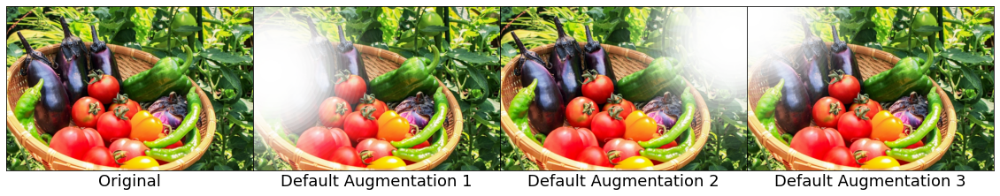

In [52]:
aug = []
n = 3
aug.append(A.Compose([A.RandomSunFlare(p=1)]))
aug.append(A.Compose([A.RandomSunFlare(p=1)]))
aug.append(A.Compose([A.RandomSunFlare(p=1)]))
aug_img = [aug[i](image=img) for i in range(n)]

fig, ax = plt.subplots(1, 1+n, figsize=(5+5*n, 5))
plt.subplots_adjust(wspace=0)
plt.rcParams["font.size"] = 18
[ax[i].tick_params(bottom=False, left=False, right=False, top=False, labelbottom=False, labelleft=False, labelright=False, labeltop=False) for i in range(1+n)]

ax[0].set_xlabel("Original")
ax[1].set_xlabel("Default Augmentation 1")
ax[2].set_xlabel("Default Augmentation 2")
ax[3].set_xlabel("Default Augmentation 3")

ax[0].imshow(img)
[ax[i+1].imshow(aug_img[i]['image']) for i in range(n)]

## RandomShadow
### Simulates shadows for the image
### 影をシミュレートする
* shadow_roi (float, float, float, float) – region of the image where shadows will appear (x_min, y_min, x_max, y_max). All values should be in range [0, 1].
* num_shadows_lower (int) – Lower limit for the possible number of shadows. Should be in range [0, num_shadows_upper].
* num_shadows_upper (int) – Lower limit for the possible number of shadows. Should be in range [num_shadows_lower, inf].
* shadow_dimension (int) – number of edges in the shadow polygons

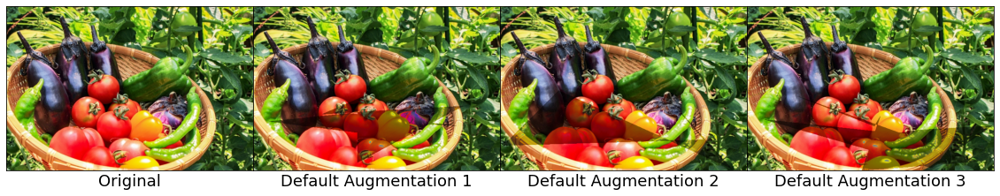

In [53]:
aug = []
n = 3
aug.append(A.Compose([A.RandomShadow(p=1)]))
aug.append(A.Compose([A.RandomShadow(p=1)]))
aug.append(A.Compose([A.RandomShadow(p=1)]))
aug_img = [aug[i](image=img) for i in range(n)]

fig, ax = plt.subplots(1, 1+n, figsize=(5+5*n, 5))
plt.subplots_adjust(wspace=0)
plt.rcParams["font.size"] = 18
[ax[i].tick_params(bottom=False, left=False, right=False, top=False, labelbottom=False, labelleft=False, labelright=False, labeltop=False) for i in range(1+n)]

ax[0].set_xlabel("Original")
ax[1].set_xlabel("Default Augmentation 1")
ax[2].set_xlabel("Default Augmentation 2")
ax[3].set_xlabel("Default Augmentation 3")

ax[0].imshow(img)
[ax[i+1].imshow(aug_img[i]['image']) for i in range(n)]

# 他

## FancyPCA
### Augment RGB image using FancyPCA
### FancyPCAでの拡張
* alpha (float) – how much to perturb/scale the eigen vecs and vals. scale is samples from gaussian distribution (mu=0, sigma=alpha)

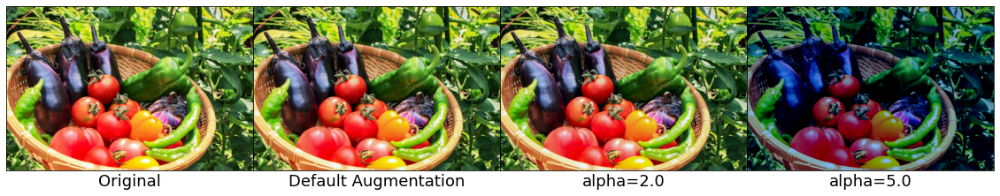

In [54]:
aug = []
n = 3
param1 = 2.0
param2 = 5.0
aug.append(A.Compose([A.FancyPCA(p=1)]))
aug.append(A.Compose([A.FancyPCA(alpha=param1, p=1)]))
aug.append(A.Compose([A.FancyPCA(alpha=param2, p=1)]))
aug_img = [aug[i](image=img) for i in range(n)]

fig, ax = plt.subplots(1, 1+n, figsize=(5+5*n, 5))
plt.subplots_adjust(wspace=0)
plt.rcParams["font.size"] = 18
[ax[i].tick_params(bottom=False, left=False, right=False, top=False, labelbottom=False, labelleft=False, labelright=False, labeltop=False) for i in range(1+n)]

ax[0].set_xlabel("Original")
ax[1].set_xlabel("Default Augmentation")
ax[2].set_xlabel("alpha={}".format(param1))
ax[3].set_xlabel("alpha={}".format(param2))

ax[0].imshow(img)
[ax[i+1].imshow(aug_img[i]['image']) for i in range(n)]

## PadIfNeeded
### Pad side of the image / max if side is less than desired number.
### 所望の解像度にするために画像端をパディングする
* min_height (int) – minimal result image height. Default: 1024.
 * 画像高さの最小値
* min_width (int) – minimal result image width. Default: 1024.
 * 画像幅の最小値

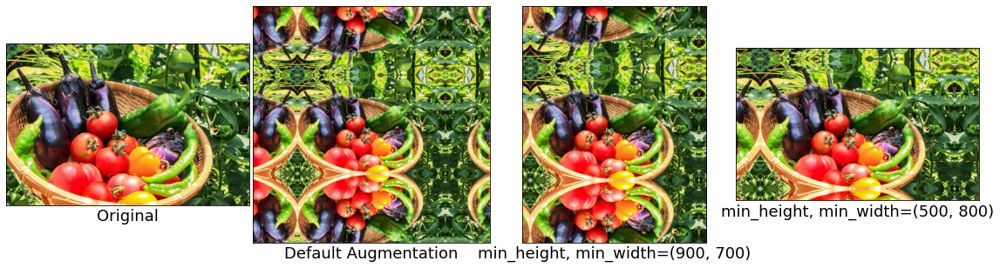

In [55]:
aug = []
n = 3
param1 = (900, 700)
param2 = (500, 800)
aug.append(A.Compose([A.PadIfNeeded(p=1)]))
aug.append(A.Compose([A.PadIfNeeded(min_height=param1[0], min_width=param1[1], p=1)]))
aug.append(A.Compose([A.PadIfNeeded(min_height=param2[0], min_width=param2[1], p=1)]))
aug_img = [aug[i](image=img) for i in range(n)]

fig, ax = plt.subplots(1, 1+n, figsize=(5+5*n, 5))
plt.subplots_adjust(wspace=0)
plt.rcParams["font.size"] = 18
[ax[i].tick_params(bottom=False, left=False, right=False, top=False, labelbottom=False, labelleft=False, labelright=False, labeltop=False) for i in range(1+n)]

ax[0].set_xlabel("Original")
ax[1].set_xlabel("Default Augmentation")
ax[2].set_xlabel("min_height, min_width={}".format(param1))
ax[3].set_xlabel("min_height, min_width={}".format(param2))

ax[0].imshow(img)
[ax[i+1].imshow(aug_img[i]['image']) for i in range(n)]

## LongestMaxSize
### Rescale an image so that maximum side is equal to max_size, keeping the aspect ratio of the initial image.
### アスペクト比を維持したまま、最大辺がmax_sizeと等しくなるように画像をリスケールする